In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline
from dataloader import Loader
import importlib
from subpixel import subpix_conv2d
from convert_mat_to_img import convert_nyu
import os
import h5py

In [3]:
current_directory = os.getcwd()
nyu_path = './nyu_depth_v2_labeled.mat'
convert_nyu(nyu_path)

load dataset: ./nyu_depth_v2_labeled.mat


In [2]:
default_activation = tf.nn.leaky_relu
def redefine_loss(logits, depths):
    logits_flat = tf.reshape(logits, [tf.shape(logits)[0],-1])
    depths_flat = tf.reshape(depths, [tf.shape(depths)[0],-1])
    predict=logits_flat
    target=depths_flat
    d = tf.subtract(predict, target)
    square_d = tf.square(d)
    sum_square_d = tf.reduce_sum(square_d, 1)
    sum_d = tf.reduce_sum(d, 1)
    sqare_sum_d = tf.square(sum_d)
    cost = tf.reduce_mean(sum_square_d / tf.cast(tf.shape(logits_flat)[1],'float32') - 0.5*sqare_sum_d / tf.cast(tf.shape(logits_flat)[1],'float32')**2)
    return cost 
def accuracy(logits, depths, delta=1.25):
    return tf.reduce_mean(tf.cast(tf.maximum(tf.divide(logits, depths), tf.divide(depths, logits))<delta, tf.float32))

In [3]:
def conv_layer(image):
    # Hidden layer with 96 neurons
    layer_1 = tf.layers.conv2d(image,filters=96,kernel_size=[11,11],strides=4,padding='VALID',activation=default_activation,name='CoarseConv1')
    layer_1 = tf.layers.max_pooling2d(layer_1,pool_size=2,strides=2,name='CoarseMax1')
    #layer_1 = tf.layers.batch_normalization(layer_1, training=is_training, name='CoarseConvBN1')
    
    # Hidden layer with 256 neurons
    layer_2 = tf.layers.conv2d(layer_1,filters=256,kernel_size=[5,5],strides=1,padding='SAME',activation=default_activation,name='CoarseConv2')
    layer_2 = tf.layers.max_pooling2d(layer_2,pool_size=[2,2],strides=2,name='CoarseMax2')
    #layer_2 = tf.layers.batch_normalization(layer_2, training=is_training, name='CoarseConvBN2')
    
    layer_3 = tf.layers.conv2d(layer_2,filters=384,kernel_size=[3,3],strides=1,padding='SAME',activation=default_activation,name='CoarseConv3')
    #layer_3 = tf.layers.batch_normalization(layer_3, training=is_training, name='CoarseConvBN3')
    
    layer_4 = tf.layers.conv2d(layer_3,filters=384,kernel_size=[3,3],strides=1,padding='SAME',activation=default_activation,name='CoarseConv4')
    #layer_4 = tf.layers.batch_normalization(layer_4, training=is_training, name='CoarseConvBN4')
    layer_5 = tf.layers.conv2d(layer_4,filters=256,kernel_size=[3,3],strides=2,padding='VALID',activation=default_activation,name='CoarseConv5')
    #layer_5 = tf.layers.batch_normalization(layer_5, training=is_training, name='CoarseConvBN5')
    return layer_5

def fully_connect_layer(conv_data,dropout,is_training):
    conv_data = tf.reshape(conv_data,[-1,conv_data.shape[1]*conv_data.shape[2]*conv_data.shape[3]])
    
    layer_1 = tf.layers.dense(conv_data,units=4096,activation=default_activation,name='CoarseFC1')
    #layer_1 = tf.layers.batch_normalization(layer_1, training=is_training, name='CoarseFCBN1')
    layer_1 = tf.layers.dropout(layer_1,rate=dropout,training=is_training,name='CoarseFCDrop1')
    
    layer_2 = tf.layers.dense(layer_1,units=4070,activation=None,name='CoarseFC2')
    #layer_2 = tf.layers.batch_normalization(layer_2, training=is_training, name='CoarseFCBN2')
    out_layer = tf.reshape(layer_2,[-1,55,74,1])
    return out_layer


In [4]:
def coarse(image, dropout, is_training):
    conv_data = conv_layer(image) #6x8x256
    coarse = fully_connect_layer(conv_data,dropout,is_training)
#     coarse = subpix_conv2d(conv_data, 128, (5,5), 3)
#     coarse = subpix_conv2d(coarse, 64, (5,5), 3)
#     coarse = tf.layers.conv2d_transpose(coarse, 1, (2,3), 1)
    return coarse #74x55x1

In [5]:
def fine(image, coarse, fine_gate, dropout, is_training):
    coarse = tf.cond(fine_gate, lambda : tf.stop_gradient(coarse), lambda : coarse)
    layer_1 = tf.layers.conv2d(image,filters=63,kernel_size=[9,9],strides=2,padding='VALID',activation=default_activation,name='FineConv1')
    layer_1_d = tf.nn.dropout(layer_1, dropout)
    print(layer_1.shape)
    #layer_1 = tf.layers.max_pooling2d(layer_1,pool_size=[2,2],strides=2,data_format='channels_last',name='FineMax1')
    #layer_1 = tf.layers.batch_normalization(layer_1, training=is_training, name='FineBN1')
    layer_2 = tf.layers.conv2d(layer_1_d,filters=63,kernel_size=[1,1],strides=2,padding='SAME',activation=default_activation,name='FineConv2')
    layer_2_d = tf.nn.dropout(layer_2, dropout)
    print(layer_2.shape)
    print(coarse.shape)
    catted = tf.concat([layer_2_d,coarse],axis=3, name='Fine1to2')
    print(catted.shape)
    
    #tf.image.resize_images(catted, size=(7,7), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    '''
    layer_3 = tf.layers.conv2d(catted,filters=64,kernel_size=[5,5],strides=1,padding='SAME',activation=default_activation,name='FineConv3')
    print(layer_3.shape)
    #layer_3 = tf.layers.batch_normalization(layer_3, training=is_training, name='FineBN2')
    layer_4 = tf.layers.conv2d(layer_3,filters=1,kernel_size=[5,5],strides=1,padding='SAME',activation=default_activation,name='FineConv4')
    print(layer_4.shape)
    #layer_4 = tf.layers.batch_normalization(layer_4, training=is_training, name='FineBN3')
    '''
    '''
    layer_3 = tf.layers.conv2d_transpose(catted,filters=64, kernel_size=[5,5],strides=(2,2),padding='same')
    print(layer_3.shape)
    layer_4 = tf.layers.conv2d_transpose(layer_3,filters=1, kernel_size=[10,10],strides=(2,2),padding='VALID')
    print(layer_4.shape)
    ##############get the extra layer from coarse that directly connect to output
    extra_coarse_1 = tf.layers.conv2d_transpose(coarse,filters=1, kernel_size=[5,5],strides=(2,2),padding='same')
    print(extra_coarse_1.shape)
    extra_coarse_2 = tf.layers.conv2d_transpose(extra_coarse_1,filters=1, kernel_size=[10,10],strides=(2,2),padding='VALID')
    print(extra_coarse_2.shape)
    '''
    
    layer_3 = subpix_conv2d(catted, 64, 5, 2, name='Fineconv3')
    print(layer_3.shape)
    layer_4 = subpix_conv2d(layer_3, 1, 5, 2, name='Fineconv4')
    print(layer_4.shape)
    ##############get the extra layer from coarse that directly connect to output
    extra_coarse_1 = subpix_conv2d(coarse, 64, 5, 2, name='coarse2out1')
    print(extra_coarse_1.shape)
    extra_coarse_2 = subpix_conv2d(extra_coarse_1, 1, 5, 2, name='coarse2out2')
    print(extra_coarse_2.shape)
    
    out = tf.cond(is_training,
                  lambda : tf.cond(fine_gate, lambda : layer_4, lambda : 0.1*layer_4+0.9*extra_coarse_2),#coarse
                  lambda : layer_4)
    return out

In [6]:
def augment(images,depths,crop_size,scale_range,rot_range,flip):
    catted = tf.concat([images, depths], axis=3)
    s = tf.random_uniform([], *scale_range)
    scaled = tf.image.resize_images(catted, tf.cast(tf.cast(tf.shape(catted)[1:3], tf.float32)*s, tf.int32))
    scaled = tf.concat([scaled[...,:-1], tf.divide(scaled[...,-1:], s)], axis=3)
    #rotated = tf.contrib.image.rotate(scaled, tf.random_uniform([tf.shape(scaled)[0],], *rot_range)/180*3.14159265)
    rotated = scaled
    cropped = tf.map_fn(lambda img: tf.random_crop(img, (crop_size[0], crop_size[1], catted.shape[3])), rotated)
    if flip:
        out = tf.map_fn(lambda img: tf.image.random_flip_left_right(img), cropped)
    else:
        out = cropped
    return out[...,0:3], out[...,3:]

def preprocess(images, depths, crop_size, depth_size=(220,296), scale_range=(0.5,1.5), rot_range=(-5,5), flip=True):
    image,depth = augment(images, depths, crop_size, scale_range, rot_range, flip)
    depth = tf.image.resize_images(depth, depth_size)
    return image*2/255-1, depth*2/255-1

In [9]:
INIT_LR = 0.0001
DECAY_SPEED = 1/20

tf.reset_default_graph() 

global_step = tf.Variable(0.0, trainable=False)

with tf.name_scope('Reader'):
    reader = Loader(imagepath='./nyu_data/*.jpg', depthpath='./nyu_data/*.png', batch_size=4, seed=0)
    train_img_reader, train_depth_reader = reader.get_train_reader()
    test_img_reader, test_depth_reader = reader.get_test_reader()
with tf.name_scope('Preprocess'):
    train_imgs, train_depths = preprocess(train_img_reader, train_depth_reader, crop_size=[228,304], depth_size=[220,296])#[55,74])
    test_imgs, test_depths = preprocess(test_img_reader, test_depth_reader, crop_size=[228,304], depth_size=[220,296], scale_range=(0.475,0.475), rot_range=(0,0), flip=False)
with tf.name_scope('Parameters'):
    fine_gate = tf.placeholder_with_default(True,shape=[])
    learning_rate = INIT_LR/(1+DECAY_SPEED*global_step)
    is_training = tf.placeholder_with_default(False, [])
with tf.name_scope('Model'):
    img_input = tf.placeholder(tf.float32,[None,228,304,3])
    depth_input = tf.placeholder(tf.float32,[None,220,296,1])
    coarse_output = coarse(img_input, 0.3, is_training)
    refined_output = fine(img_input, coarse_output, fine_gate, 0.3, is_training)
with tf.name_scope('Loss'):
    loss_op = redefine_loss(refined_output, depth_input)
with tf.name_scope('Adam'):
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
    with tf.control_dependencies(update_ops):
        train_op = optimizer.minimize(loss_op)
#print(refined_output.shape,depth_input.shape)
with tf.name_scope('Accuracy'):
    accuracy_op = accuracy(refined_output, depth_input, 1.25)

running_loss_sum = tf.placeholder(tf.float32, [])
running_accuracy_sum = tf.placeholder(tf.float32, [])
input_image_sum = tf.placeholder(tf.float32, [1,228,304,3])
input_depth_sum = tf.placeholder(tf.float32, [1,220,296,1])
coarse_sum = tf.placeholder(tf.float32, [1,55,74,1])
refined_sum = tf.placeholder(tf.float32, [1,220,296,1])

train_summary = tf.summary.merge([
    tf.summary.scalar('train_running_loss', running_loss_sum),
    tf.summary.scalar('train_running_accuracy', running_accuracy_sum),
    tf.summary.scalar('learning_rate', learning_rate),
    tf.summary.image('train_input', input_image_sum),
    tf.summary.image('train_target', input_depth_sum),
    tf.summary.image('train_coarse', coarse_sum),
    tf.summary.image('train_output', refined_sum)
])
test_summary = tf.summary.merge([
    tf.summary.scalar('test_loss', running_loss_sum),
    tf.summary.scalar('test_accuracy', running_accuracy_sum),
    tf.summary.image('test_input', input_image_sum),
    tf.summary.image('test_target', input_depth_sum),
    tf.summary.image('test_coarse', coarse_sum),
    tf.summary.image('test_output', refined_sum)
])


(?, 110, 148, 63)
(?, 55, 74, 63)
(?, 55, 74, 1)
(?, 55, 74, 64)
(?, 110, 148, 64)
(?, 220, 296, 1)
(?, 110, 148, 64)
(?, 220, 296, 1)


In [10]:
def normalize(image):
    img = image-np.min(image)
    return (img)/np.max(img)

INFO:tensorflow:Restoring parameters from ./logs/NOBN_linear_augment_0001/CSE291FinalModel_test.ckpt-60
Checkpoint recovered ./logs/NOBN_linear_augment_0001/CSE291FinalModel_test.ckpt-60
61.0 0.565659500659
0.225976081462


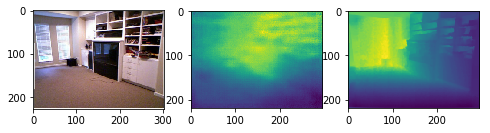

62.0 0.519381864203
0.266263778839


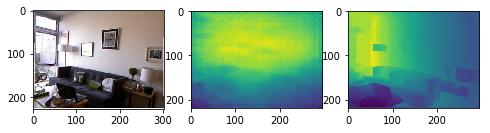

63.0 0.567682517072
0.224116375049


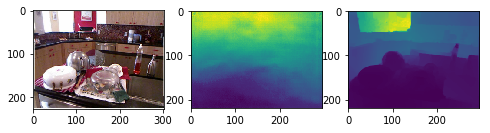

64.0 0.466080507884
0.323649181674


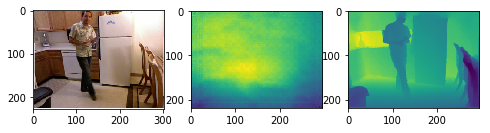

65.0 0.464318351613
0.30483125233


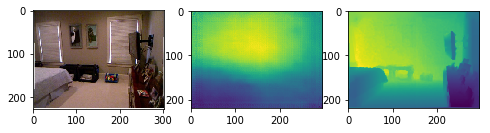

66.0 0.502135076457
0.284107224188


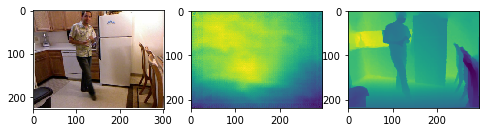

67.0 0.512787467076
0.268746588379


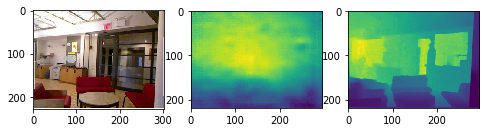

68.0 0.588200163924
0.199515316635


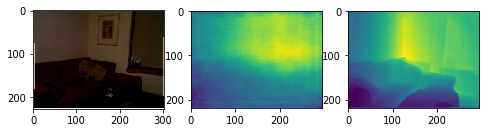

69.0 0.480750206444
0.287831439947


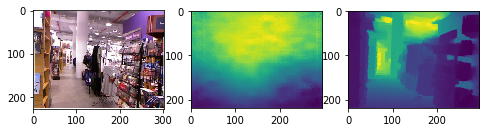

70.0 0.463927738369
0.372010968212


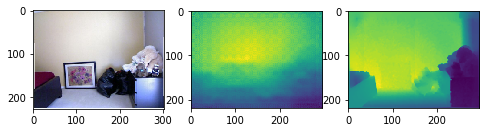

71.0 0.467586468491
0.300751603726


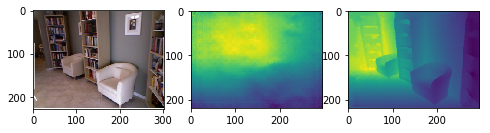

72.0 0.466700784862
0.31358346819


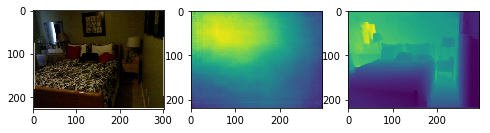

73.0 0.496214621597
0.256242108014


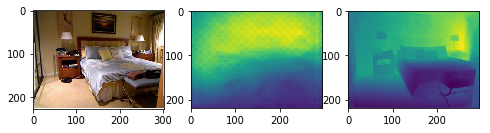

74.0 0.537623624007
0.248182521926


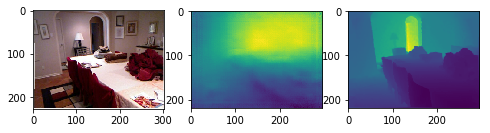

75.0 0.542117891212
0.229208468977


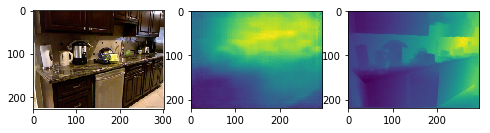

76.0 0.46791503744
0.286557722837


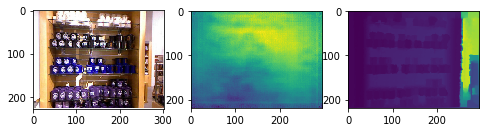

77.0 0.456200628645
0.323036852396


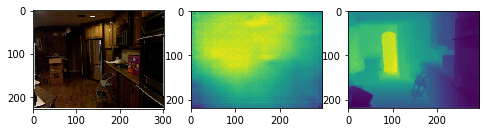

78.0 0.453577741153
0.333987683679


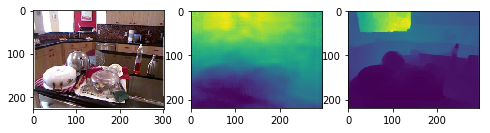

79.0 0.471536011746
0.307476475421


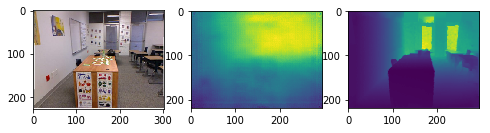

80.0 0.475650544796
0.297058102157


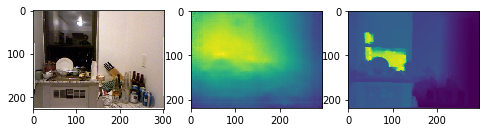

81.0 0.431105934911
0.3272330554


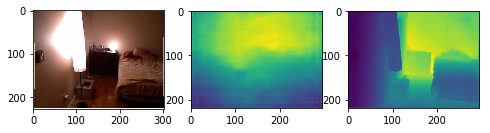

82.0 0.460216531323
0.267208505836


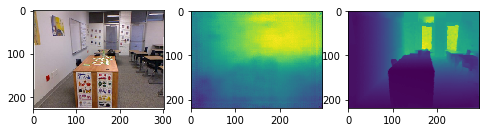

83.0 0.517154755692
0.26888863287


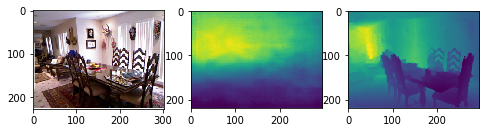

84.0 0.471288871434
0.266829401669


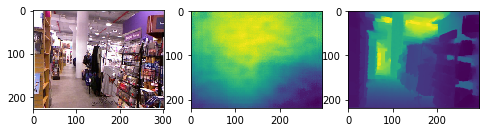

85.0 0.483019149138
0.275718333407


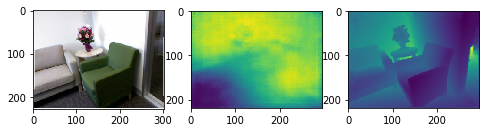

86.0 0.448472383122
0.308291957817


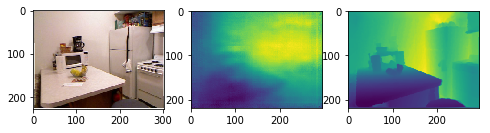

87.0 0.490370469789
0.2636982157


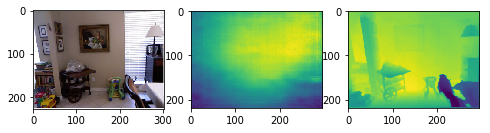

88.0 0.455170618163
0.286641328699


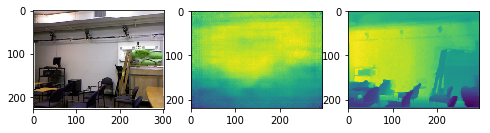

89.0 0.534471747776
0.228534714371


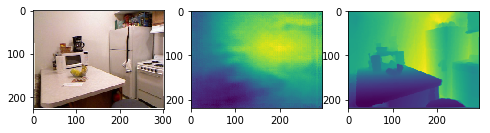

90.0 0.439392939624
0.321537055282


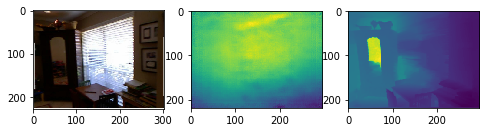

91.0 0.432976961136
0.336303065634


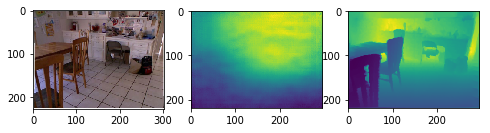

92.0 0.451384710769
0.302016364204


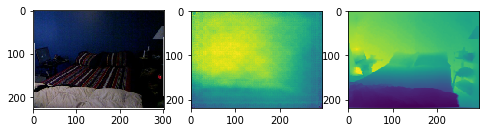

93.0 0.470260516637
0.284103597411


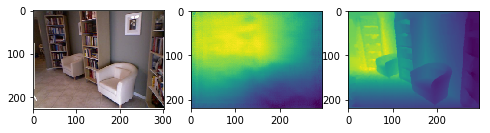

94.0 0.420358599888
0.333624993347


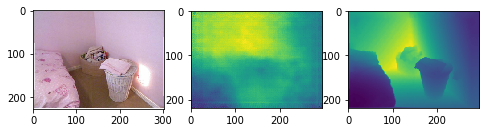

95.0 0.436049309042
0.318424212022


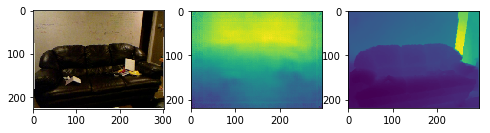

96.0 0.460223735207
0.293982902749


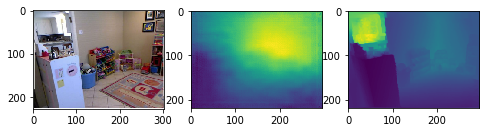

97.0 0.471474549009
0.277558738262


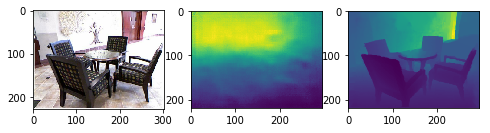

98.0 0.479029060238
0.288183673181


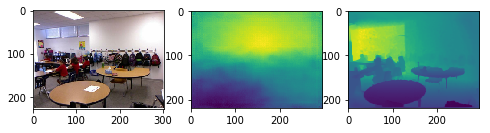

99.0 0.448692312671
0.290026425901


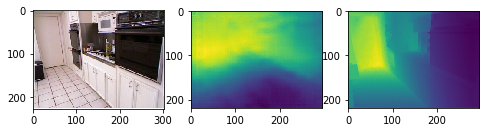

100.0 0.440931300322
0.295353771084


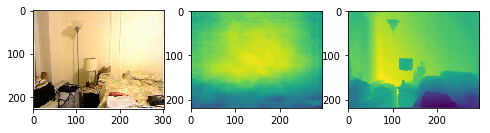

101.0 0.492429416213
0.25876160173


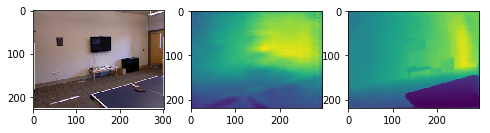

102.0 0.511022989121
0.229358940903


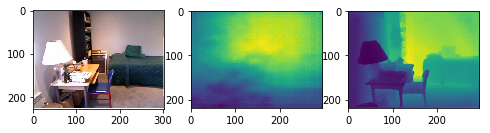

103.0 0.447039429926
0.290508975585


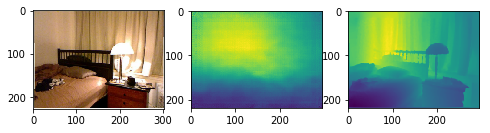

104.0 0.508890136249
0.254346782342


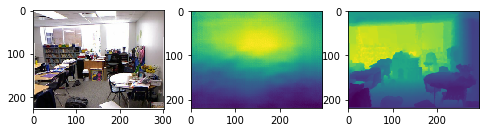

105.0 0.458738735153
0.276682259308


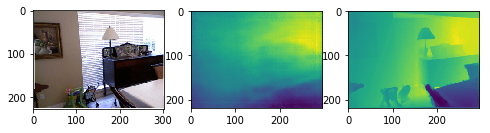

106.0 0.415334605508
0.332087130182


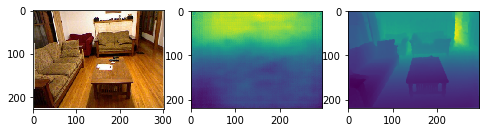

107.0 0.462887618277
0.274292117813


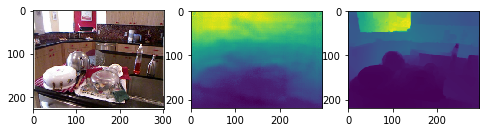

108.0 0.429307662778
0.30605932739


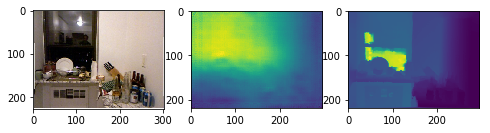

109.0 0.485784658955
0.270109453963


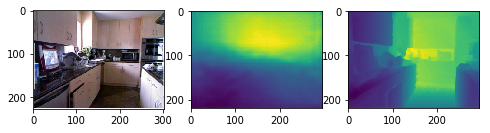

110.0 0.484393647975
0.253873830351


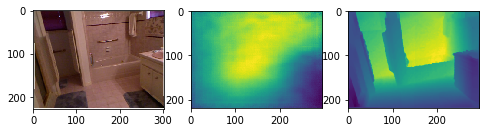

111.0 0.415484737191
0.325900260773


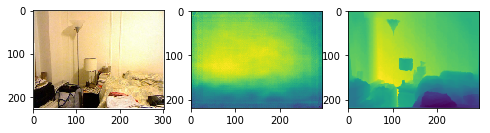

112.0 0.51748228487
0.242392994877


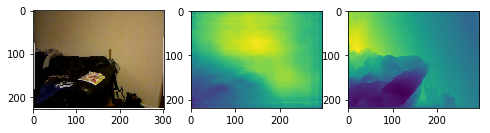

113.0 0.403404628237
0.386086480071


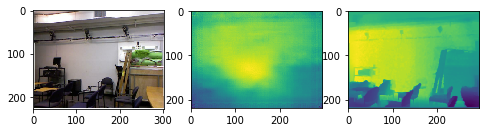

114.0 0.45609412094
0.322821438313


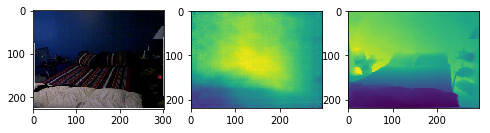

115.0 0.445842152668
0.29559264539


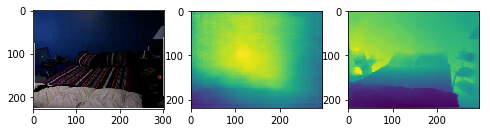

116.0 0.440904046512
0.307753631224


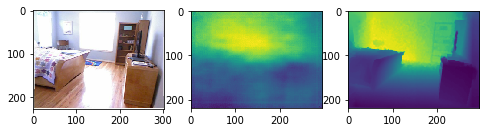

117.0 0.473094284534
0.250672476159


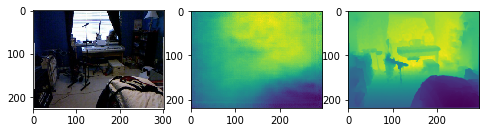

118.0 0.407757988407
0.39210314552


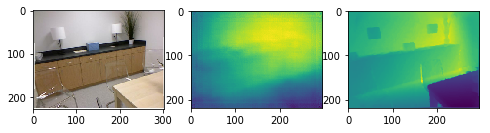

119.0 0.448479867644
0.278600831413


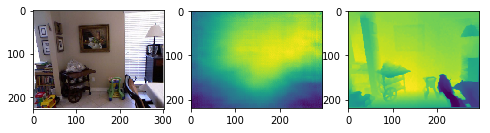

120.0 0.482691191137
0.259039933586


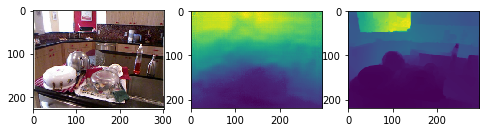

121.0 0.421832890974
0.293335273655


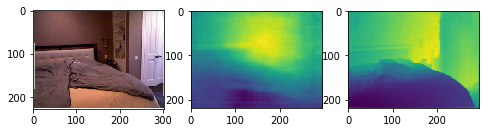

122.0 0.479002951748
0.269256649953


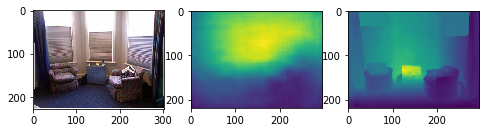

123.0 0.416722756293
0.338955114699


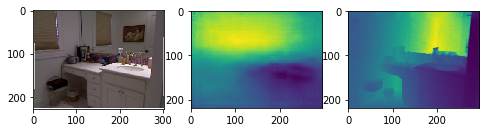

124.0 0.453936479158
0.299095900833


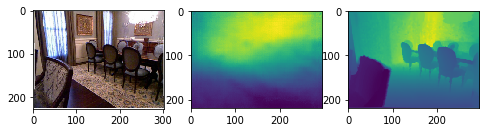

125.0 0.472920168605
0.240598338553


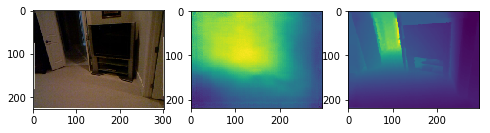

126.0 0.398902398845
0.352235937698


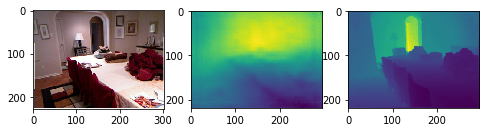

127.0 0.440053159992
0.294286190222


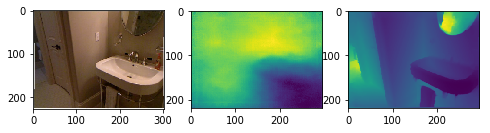

128.0 0.482506990433
0.266663787266


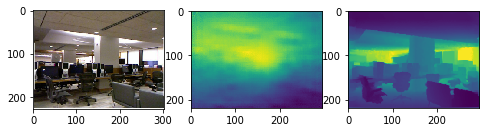

129.0 0.44766686774
0.2811110475


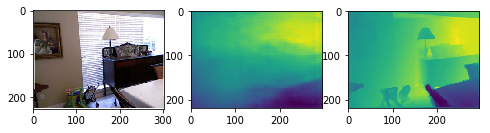

130.0 0.436990708941
0.269906414259


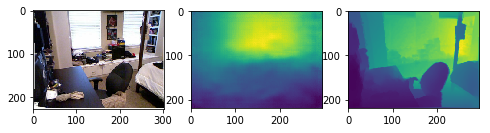

131.0 0.44151497922
0.295493254645


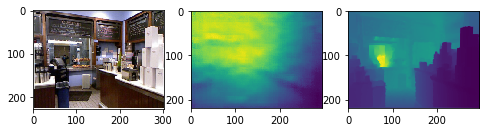

132.0 0.411810695711
0.39017892008


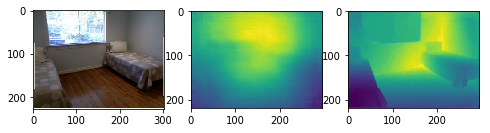

133.0 0.441894085871
0.291640325553


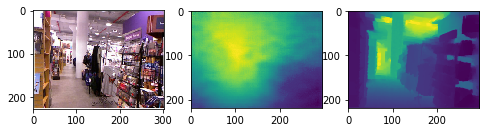

134.0 0.418604638427
0.322746681463


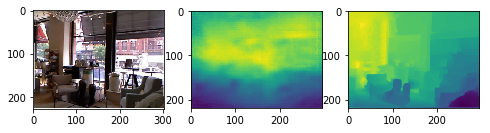

135.0 0.407475355599
0.355376720635


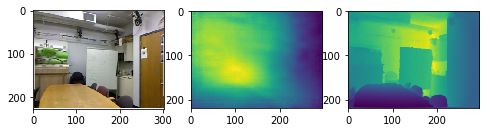

136.0 0.447327236334
0.288742577243


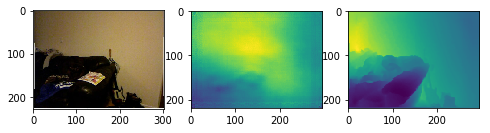

137.0 0.445355947647
0.299624944313


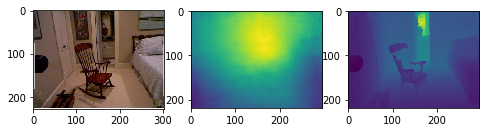

138.0 0.395016638769
0.388148161686


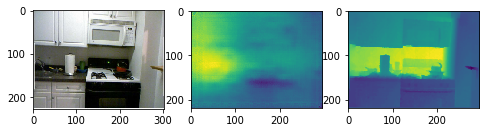

139.0 0.418893031362
0.302034277469


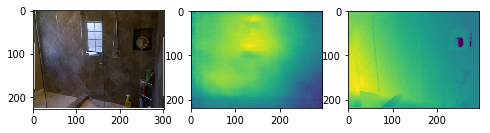

140.0 0.460041522152
0.267186752831


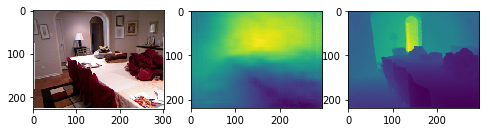

141.0 0.426289429267
0.312957488


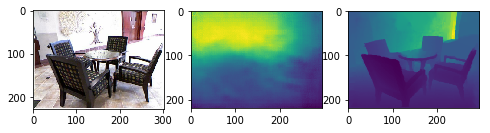

142.0 0.397070155376
0.365958894706


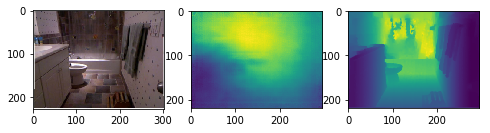

143.0 0.442101502584
0.282398518175


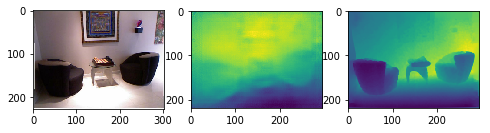

144.0 0.424918773274
0.350067399028


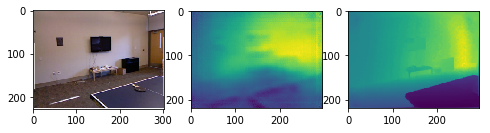

145.0 0.41365499422
0.352478647398


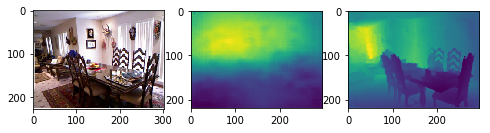

146.0 0.425584651944
0.319166327516


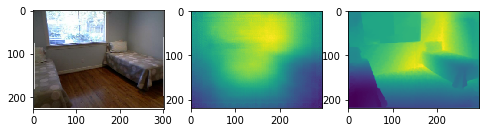

147.0 0.407612718642
0.332439151489


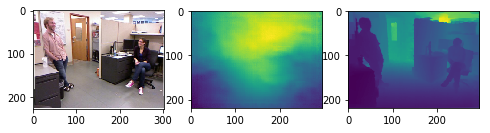

148.0 0.464952698184
0.277172805534


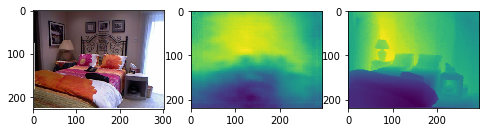

149.0 0.393009913464
0.366745688021


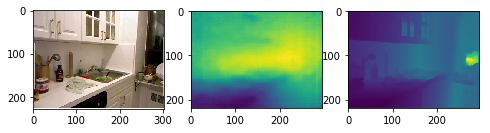

150.0 0.424658187562
0.294208342002


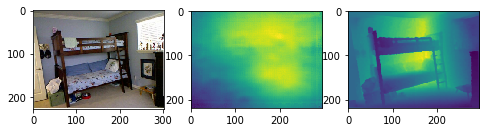

151.0 0.416393950995
0.424147727589


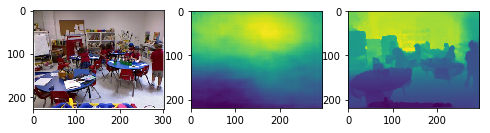

152.0 0.432417602589
0.296330172155


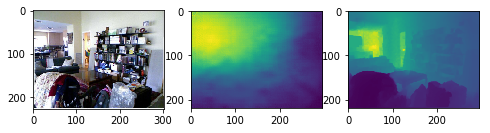

153.0 0.386658025699
0.360839603676


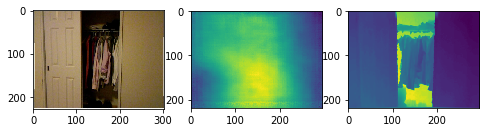

154.0 0.414144963026
0.290965825112


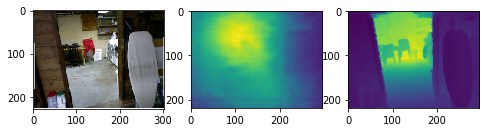

155.0 0.39664865161
0.36186751268


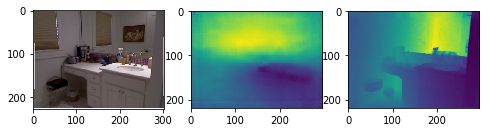

156.0 0.429978082163
0.322411190718


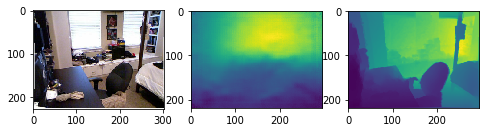

157.0 0.412365362462
0.334780980315


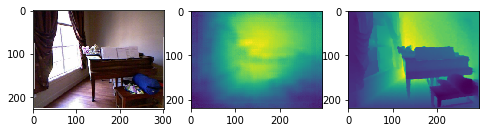

158.0 0.41643890159
0.336698274646


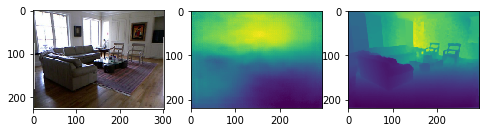

159.0 0.41521796253
0.330885610647


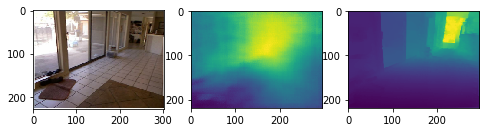

160.0 0.425315304763
0.309386088927


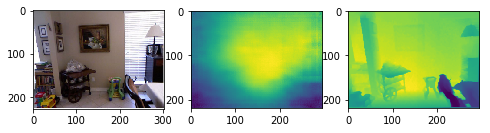

161.0 0.406283928288
0.334290219885


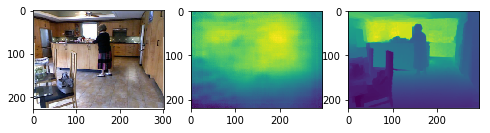

162.0 0.407783778177
0.335613848021


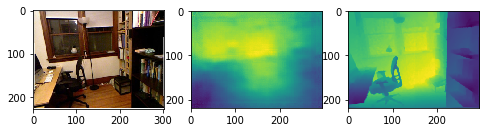

163.0 0.388548280216
0.36645402511


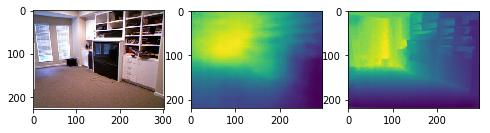

164.0 0.424863795025
0.325954223673


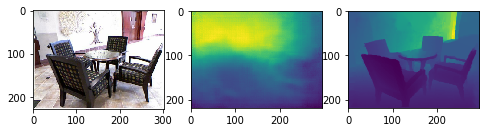

165.0 0.414868071261
0.324829266717


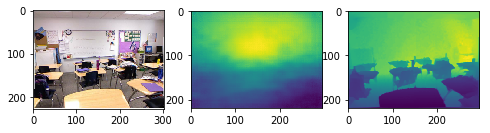

166.0 0.434642012335
0.314790005899


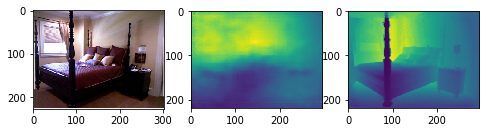

167.0 0.443164289825
0.288095269145


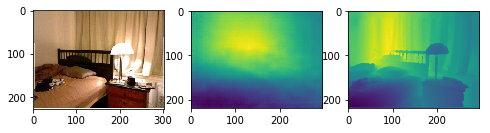

168.0 0.439274177783
0.277863517404


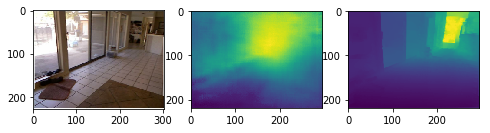

169.0 0.415879634519
0.312578062423


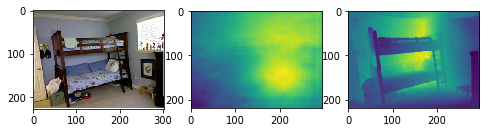

170.0 0.425151817915
0.294397203459


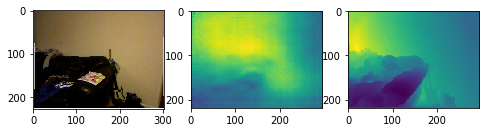

171.0 0.424189011256
0.290168684804


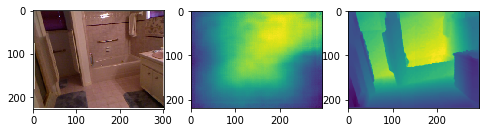

172.0 0.45358887439
0.277571641737


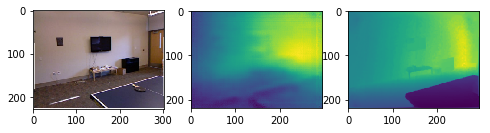

173.0 0.409623684982
0.314721540444


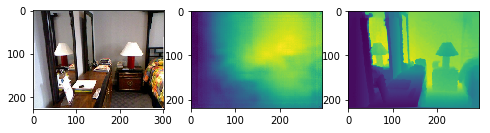

174.0 0.436321583059
0.334505421627


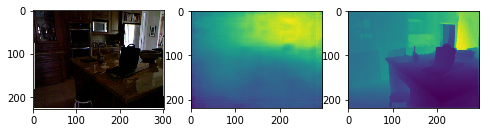

175.0 0.438141286373
0.287561211735


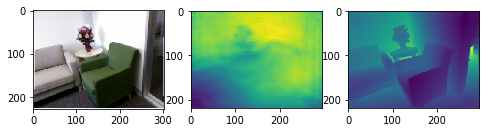

176.0 0.432029773792
0.321586218973


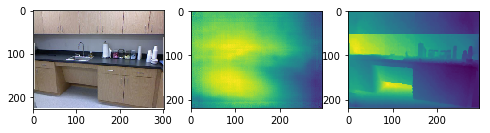

177.0 0.413196454032
0.308841049257


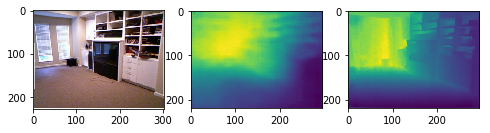

178.0 0.382023833692
0.354564221783


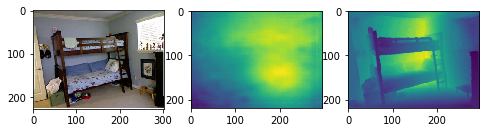

179.0 0.417913865298
0.333930842164


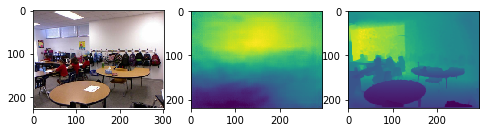

180.0 0.465718097985
0.244238948243


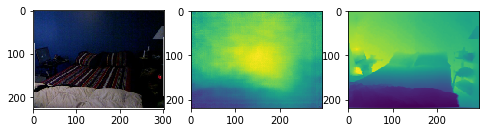

181.0 0.437209226191
0.282763230925


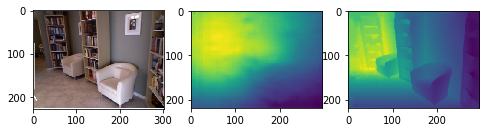

182.0 0.424409487595
0.292950621496


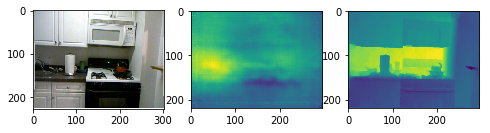

183.0 0.443781908188
0.291205230583


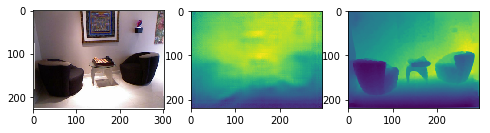

184.0 0.424206387666
0.272434224064


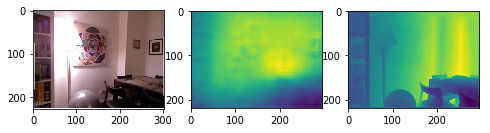

185.0 0.422284713636
0.298331391894


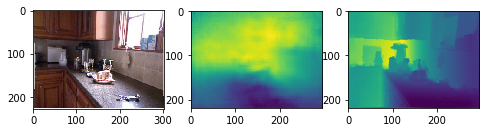

186.0 0.419874348574
0.304665106452


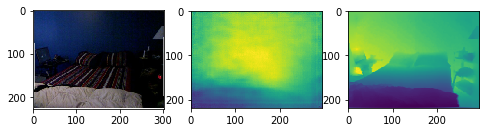

187.0 0.400797909747
0.353421461251


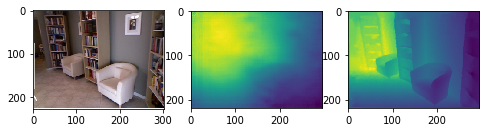

188.0 0.419993285504
0.319577638888


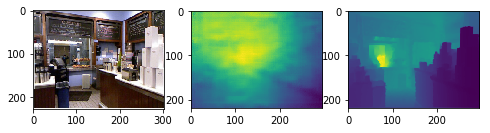

189.0 0.421070677539
0.304389652072


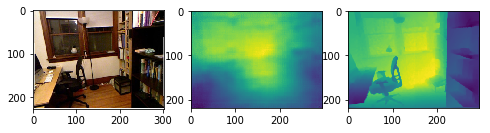

190.0 0.475817571084
0.232184813668


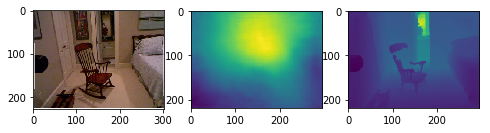

191.0 0.452106555303
0.262403809155


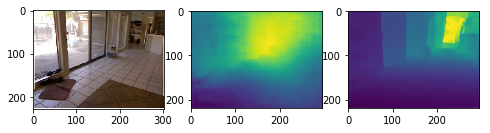

192.0 0.445922635496
0.26855271558


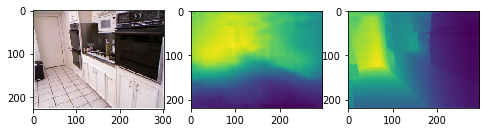

193.0 0.402778336157
0.289548249087


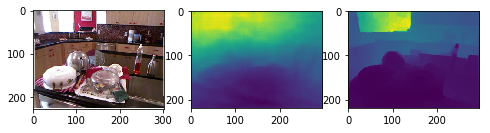

194.0 

In [ ]:
from datetime import datetime
from PIL import Image
now = datetime.now()

Nth_RUN = 'NOBN_linear_augment_0001'
training_epochs=1000
logs_path = './logs/{}'.format(Nth_RUN)
saver = tf.train.Saver()
with tf.Session(config=tf.ConfigProto(allow_soft_placement=True)) as sess:
    tf.global_variables_initializer().run(session=sess)
    tf.local_variables_initializer().run(session=sess)
    
    latest_ckpt = tf.train.latest_checkpoint(logs_path)
    if latest_ckpt:
        saver.restore(sess, latest_ckpt)
        print('Checkpoint recovered', latest_ckpt)
    
    summary_writer = tf.summary.FileWriter(logs_path, graph=tf.get_default_graph())
    # start queue loader (for data)
    coord = tf.train.Coordinator()
    threads = tf.train.start_queue_runners(coord = coord)
    # Training cycle
    training_coarse = 2
    while sess.run(tf.assign_add(global_step, 1)) < training_epochs:
        print(sess.run(global_step), end=' ')
        train_loss = 0
        train_accu = 0
        for s in range(reader.n_batches()[0]):
            batch_img, batch_depth = sess.run([train_imgs, train_depths])
            _, cur_loss, cur_accu = sess.run([train_op, loss_op, accuracy_op], feed_dict={img_input:batch_img, 
                                                           depth_input:batch_depth, 
                                                           fine_gate:not training_coarse, 
                                                           is_training:True})
            #print(cur_loss)
            #print(cur_accu)
            training_coarse = training_coarse-1
            if training_coarse<0:
                training_coarse = 2
            #print(reader.size())
            train_loss += cur_loss/reader.size()[0]*batch_img.shape[0]#/reader.n_batches()[0]
            train_accu += cur_accu/reader.size()[0]*batch_img.shape[0]#/reader.n_batches()[0]
            #print(cur_loss)
            #print(cur_accu)
        #print(train_loss)
        #print(train_accu)
        I,D = sess.run([train_imgs, train_depths])
        C,O = sess.run([coarse_output, refined_output], feed_dict={img_input:I, depth_input:D, is_training:False})
        
        summary_writer.add_summary(
            sess.run(train_summary, 
                     feed_dict={
                         running_loss_sum:train_loss,
                         running_accuracy_sum:train_accu,
                         input_image_sum:I[-1:,...], 
                         input_depth_sum:D[-1:,...], 
                         coarse_sum:C[-1:,...], 
                         refined_sum:O[-1:,...]}), global_step=sess.run(global_step))
        
        
        test_loss = 0
        test_accu = 0
        for s in range(reader.n_batches()[1]):
            tbatch_img, tbatch_depth = sess.run([test_imgs, test_depths])
            cur_loss, cur_accu = sess.run([loss_op, accuracy_op], 
                                  feed_dict={
                                      img_input:tbatch_img,
                                      depth_input:tbatch_depth,
                                      is_training:False})
            test_loss += cur_loss/reader.size()[1]*tbatch_img.shape[0]#/reader.n_batches()[1]
            test_accu += cur_accu/reader.size()[1]*tbatch_img.shape[0]#/reader.n_batches()[1]
            #print(cur_accu)
        print(test_loss)
        print(test_accu)
        TI, TD = sess.run([test_imgs, test_depths])
        TC, TO = sess.run([coarse_output, refined_output], feed_dict={img_input:TI,depth_input:TD, is_training:False})
        plt.figure(figsize=(8, 6))
        plt.subplot(131)
        test_in = normalize(TI[1])
        plt.imshow(np.reshape(test_in,[test_in.shape[0],test_in.shape[1],3]))
        plt.subplot(132)
        pred = normalize(TO[1])
        plt.imshow(np.reshape(pred,[pred.shape[0],pred.shape[1]]))
        plt.subplot(133)
        target = normalize(TD[1])
        plt.imshow(np.reshape(target,[target.shape[0],target.shape[1]]))
        plt.show()
        #print(TO.min(),TO.max())
        #print(TD.min(),TD.max())
        #print()
        #print(test_loss.shape)
        #print(cur_accu.shape)
        summary_writer.add_summary(
            sess.run(test_summary, 
                     feed_dict={
                         running_loss_sum:test_loss, 
                         running_accuracy_sum:cur_accu,
                         input_image_sum:TI[-1:,...], 
                         input_depth_sum:TD[-1:,...], 
                         coarse_sum:TC[-1:,...], 
                         refined_sum:TO[-1:,...]}), global_step=sess.run(global_step))
        
        if sess.run(global_step)%10==0:
            save_path = saver.save(sess, logs_path+"/CSE291FinalModel_test.ckpt", global_step=global_step)  #save model for second part
    # end queue loader
    coord.request_stop()
    coord.join(threads)

In [8]:
compile()

TypeError: Required argument 'source' (pos 1) not found

00007.jpg


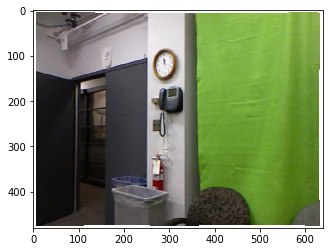

00832.png


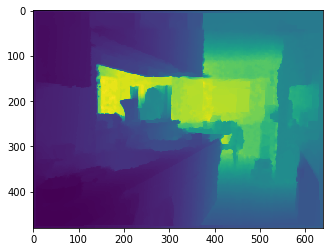

00440.png


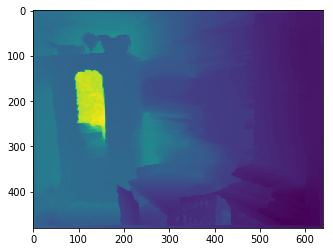

01200.png


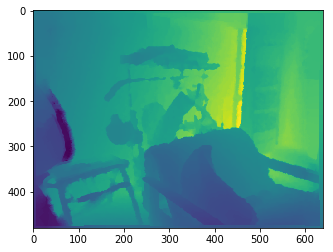

00466.jpg


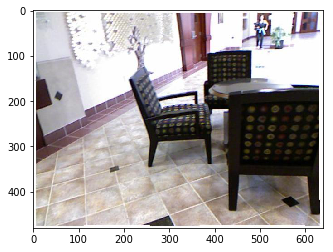

00814.jpg


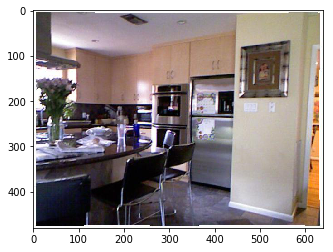

01226.jpg


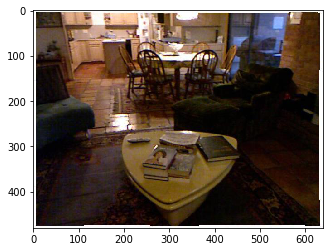

00786.png


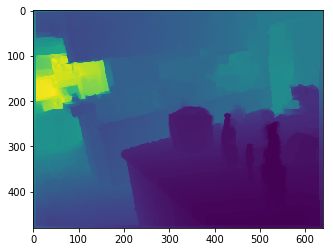

00021.png


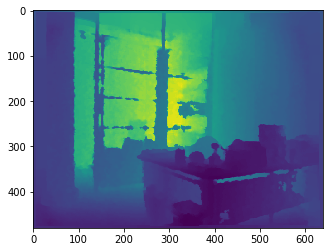

00757.png


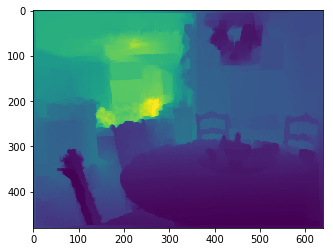

01117.png


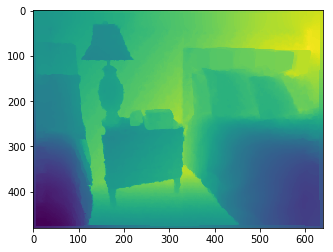

00310.jpg


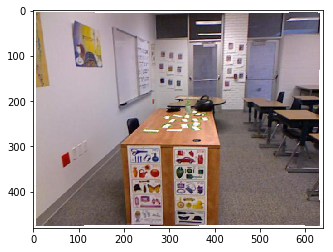

00336.png


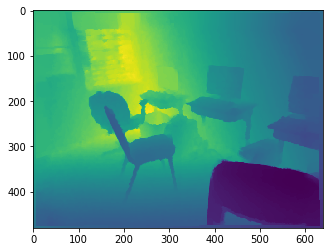

00491.png


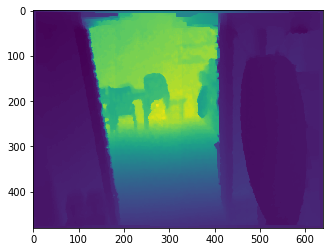

00771.jpg


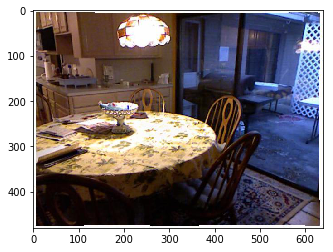

01131.jpg


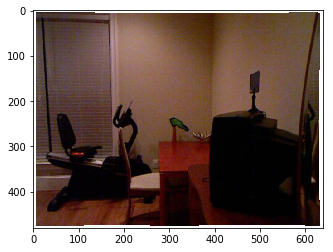

01408.jpg


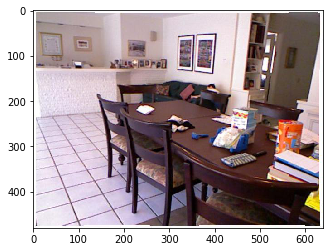

00248.jpg


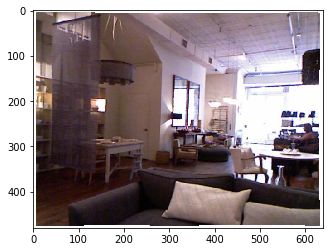

00629.jpg


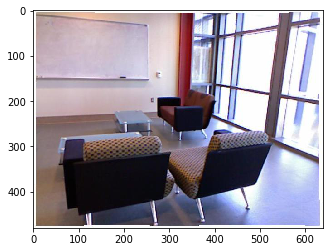

01069.jpg


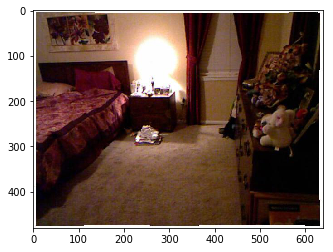

01389.png


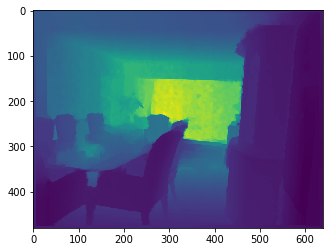

00518.png


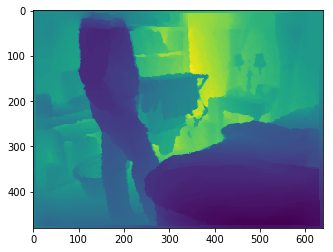

01358.png


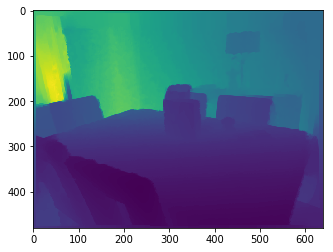

00179.png


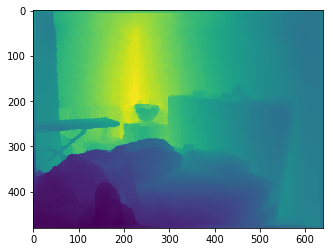

00299.jpg


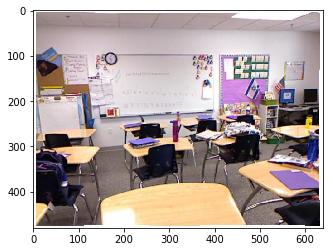

00868.jpg


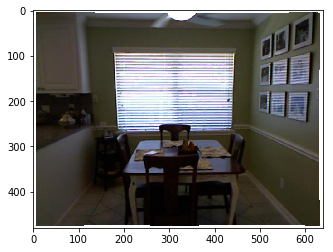

00673.png


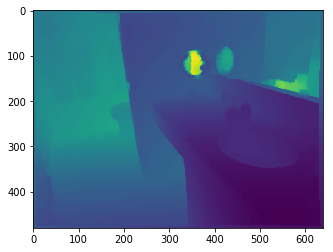

01033.png


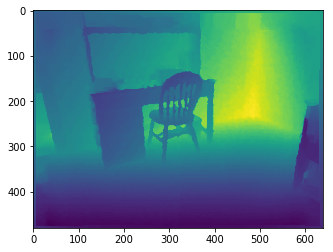

00234.jpg


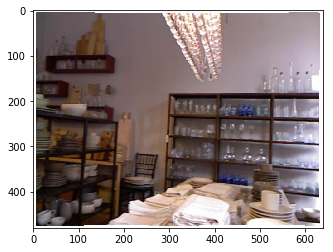

00593.jpg


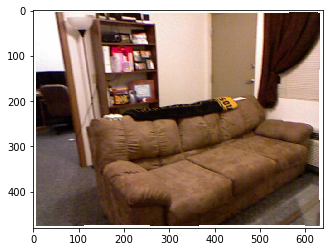

00212.png


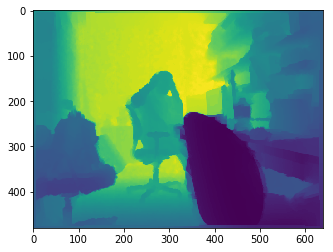

00655.jpg


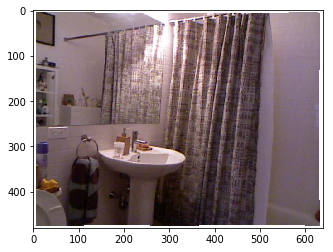

01015.jpg


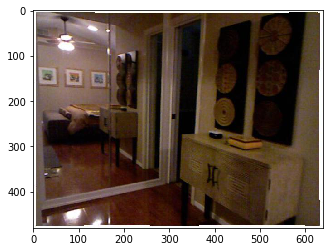

00684.jpg


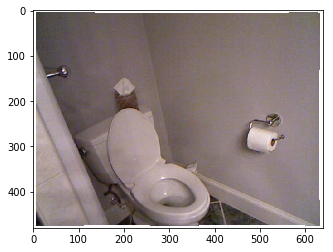

00123.jpg


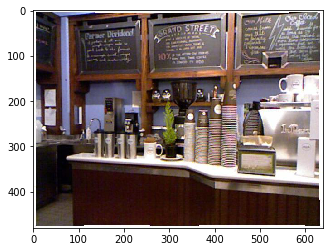

00564.png


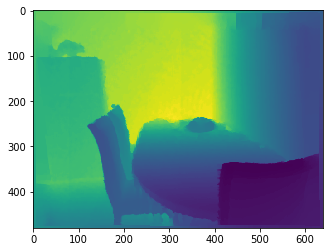

00916.png


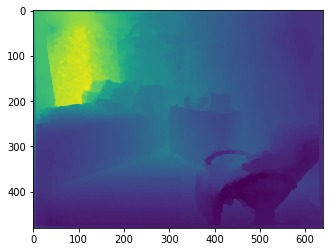

01324.png


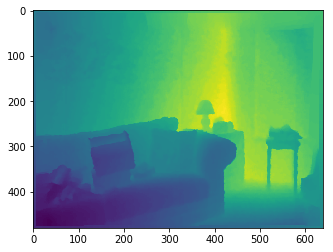

00930.jpg


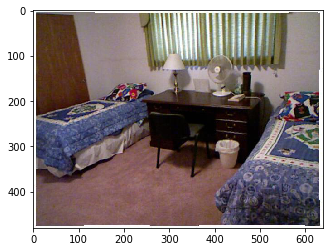

00542.jpg


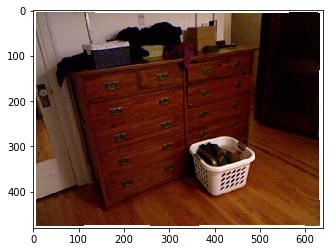

01302.jpg


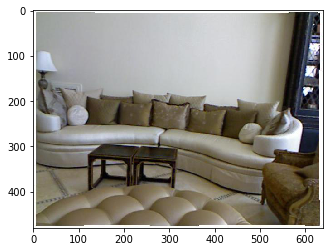

00105.png


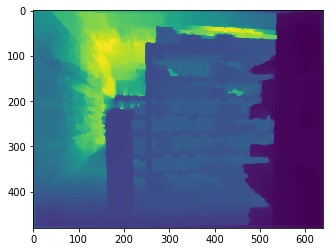

00849.png


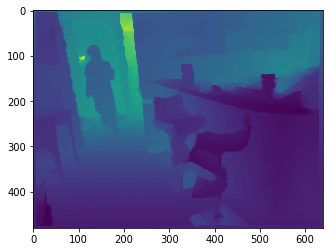

00898.png


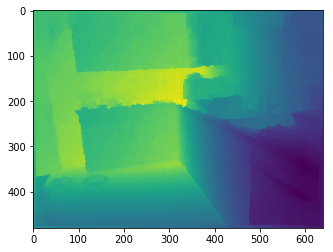

01034.png


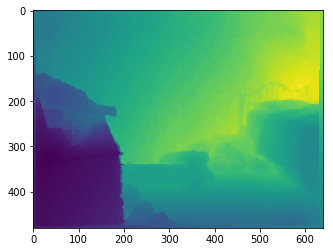

00674.png


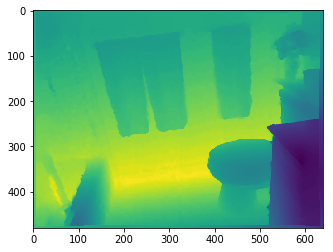

00594.jpg


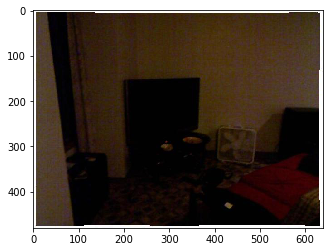

00233.jpg


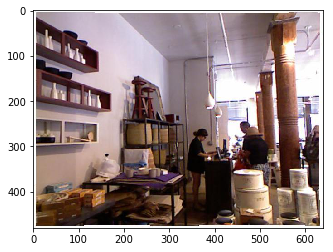

00215.png


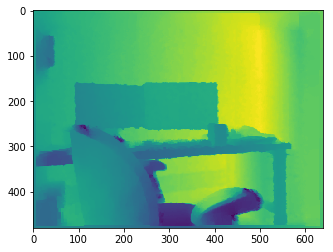

01012.jpg


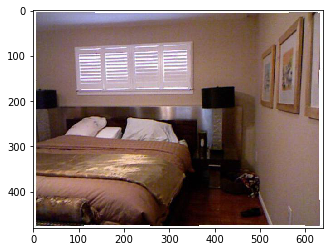

00652.jpg


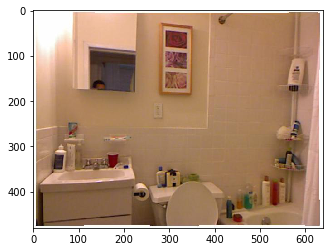

00124.jpg


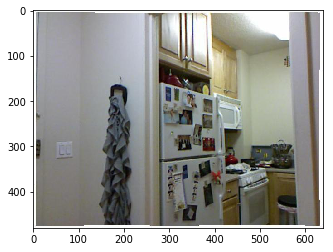

00683.jpg


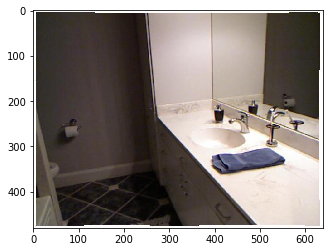

01323.png


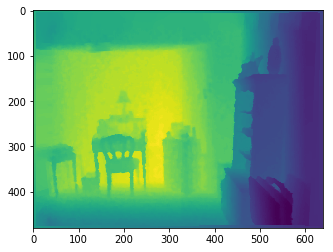

00911.png


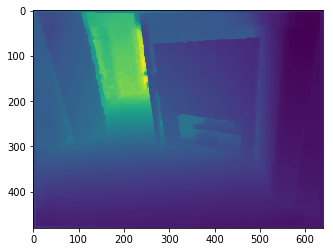

00563.png


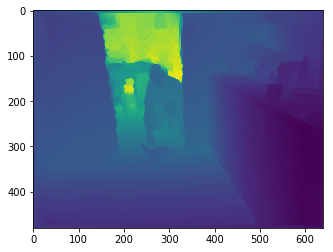

01305.jpg


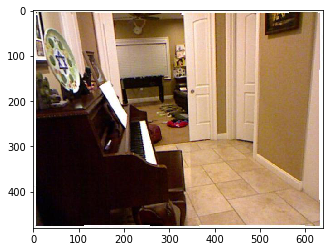

00545.jpg


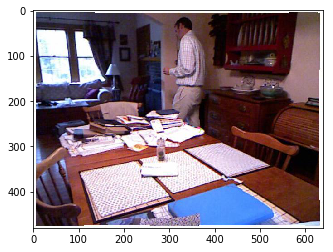

00937.jpg


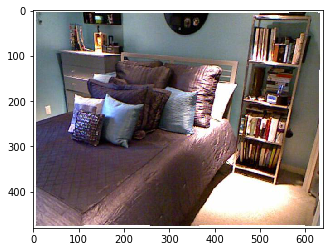

00102.png


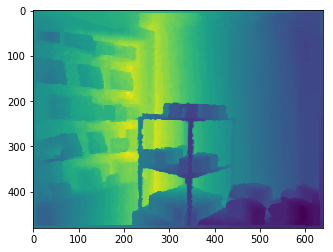

00000.jpg


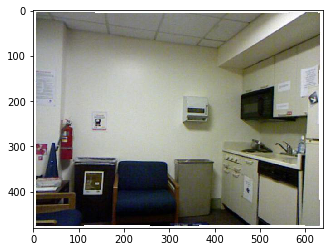

01207.png


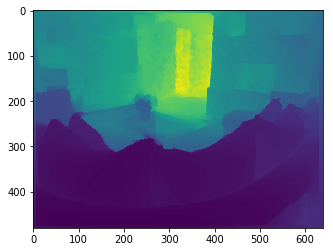

00447.png


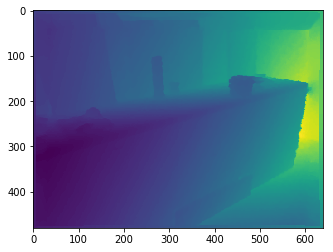

00835.png


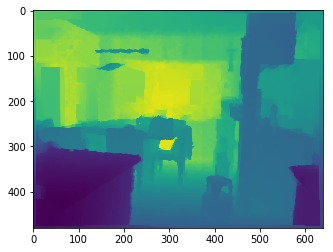

01221.jpg


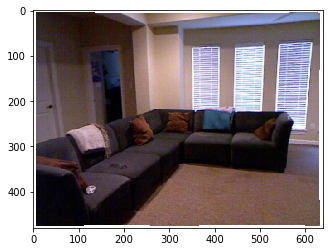

00813.jpg


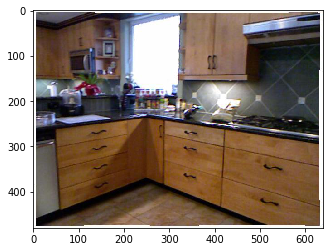

00461.jpg


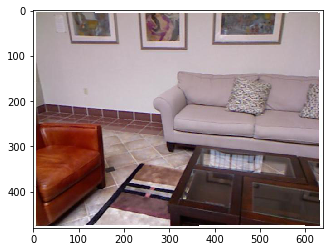

00026.png


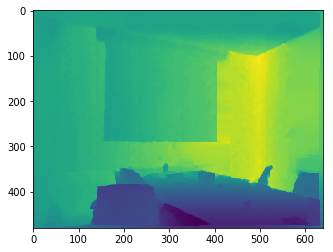

00781.png


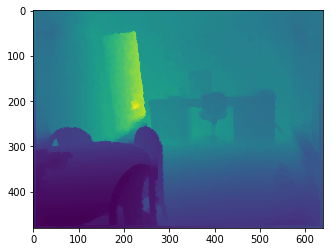

01110.png


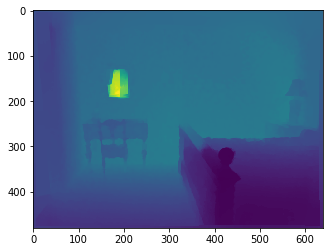

00750.png


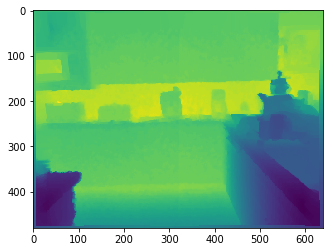

00317.jpg


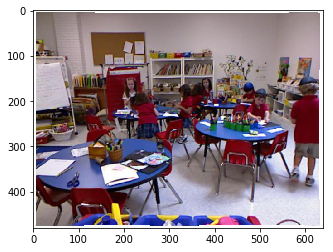

00496.png


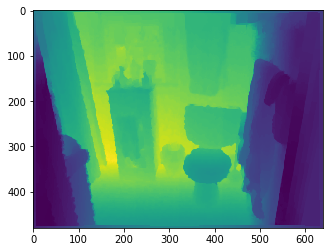

00331.png


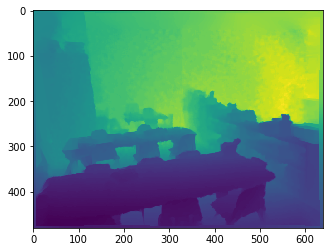

01136.jpg


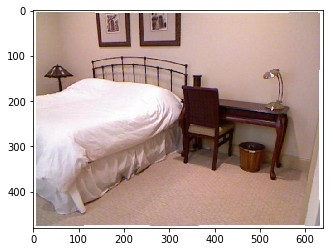

00776.jpg


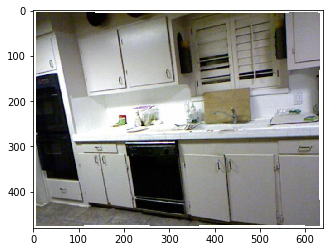

01048.png


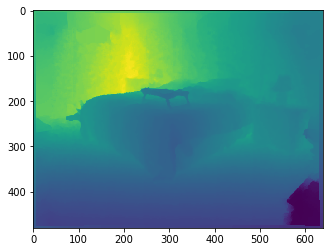

00608.png


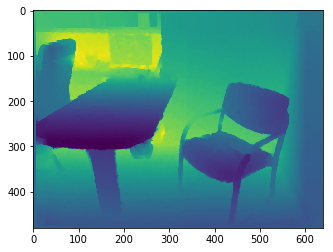

00189.jpg


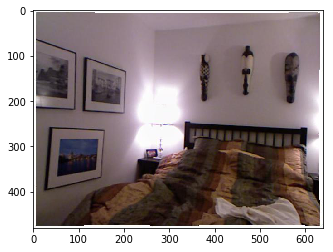

00269.png


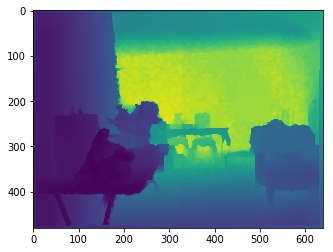

01429.png


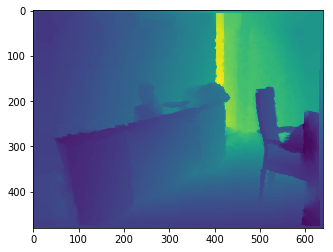

00158.jpg


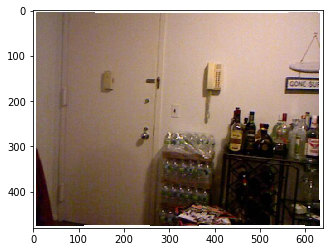

01099.png


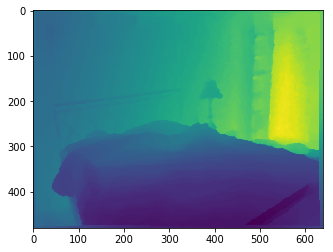

01379.jpg


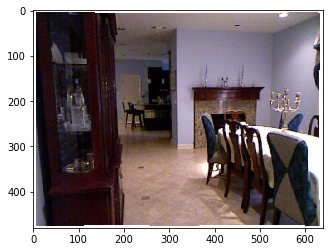

00539.jpg


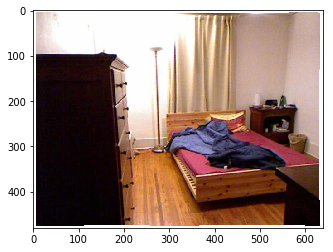

01195.jpg


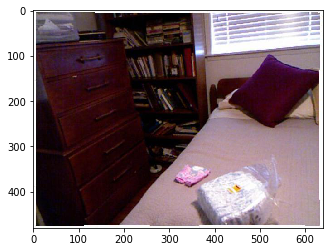

00072.jpg


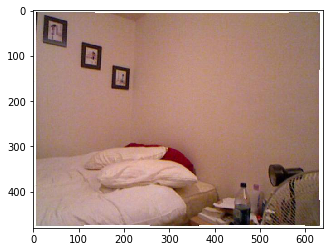

00392.png


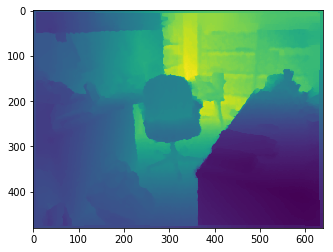

00435.png


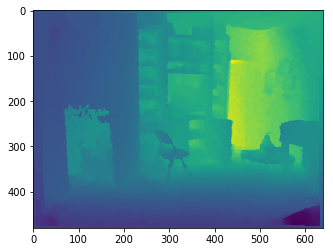

00847.png


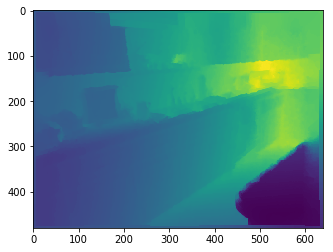

01275.png


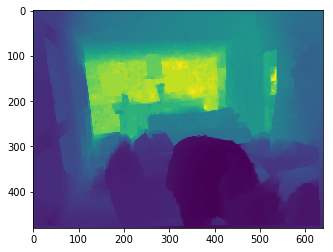

00861.jpg


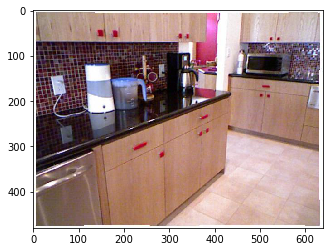

00413.jpg


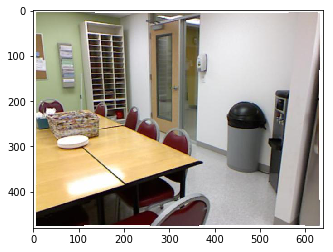

01253.jpg


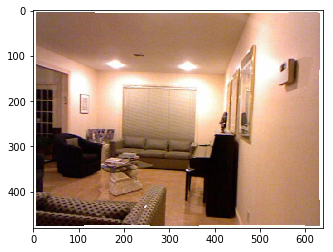

00054.png


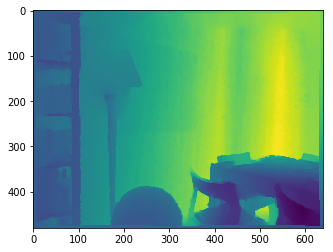

00722.png


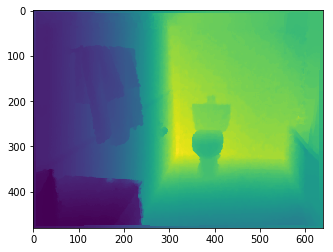

00085.png


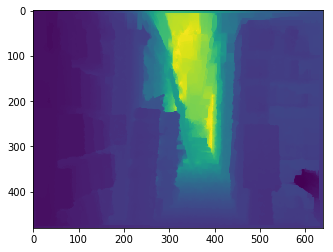

01162.png


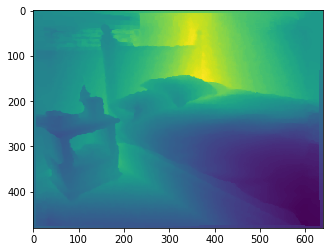

01282.jpg


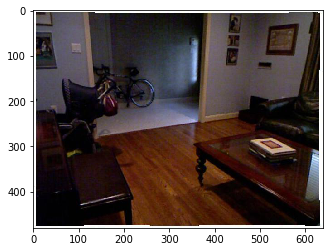

00365.jpg


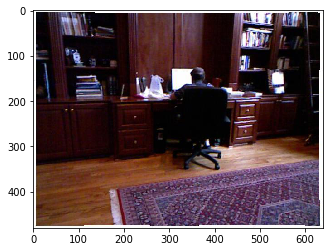

00343.png


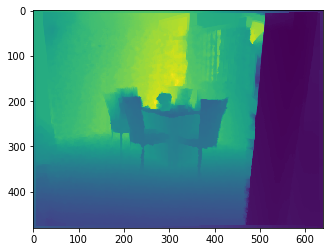

00896.png


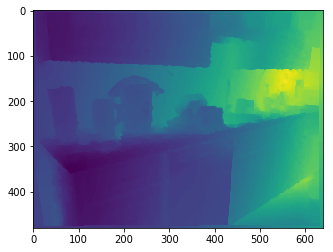

00704.jpg


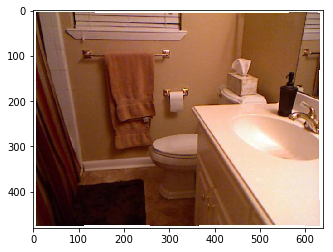

01144.jpg


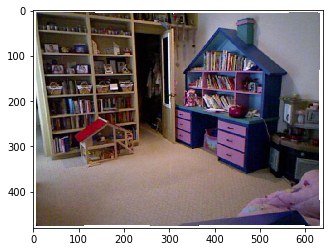

00939.jpg


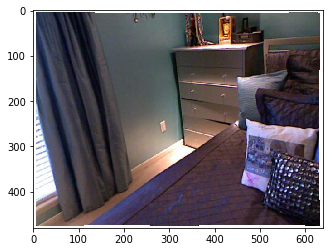

00449.png


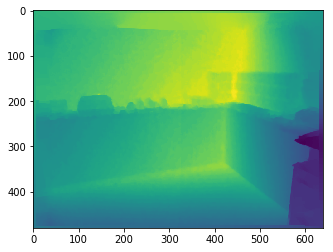

01209.png


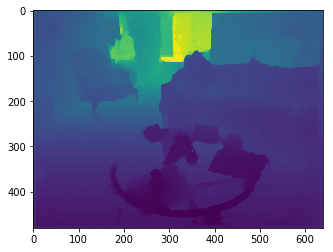

00028.png


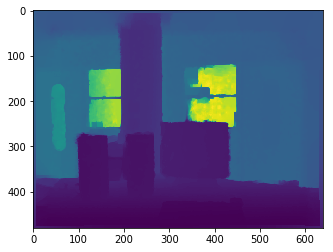

00319.jpg


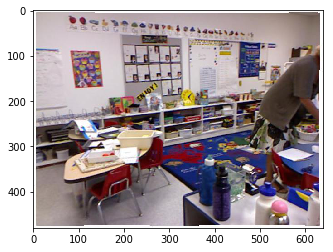

00778.jpg


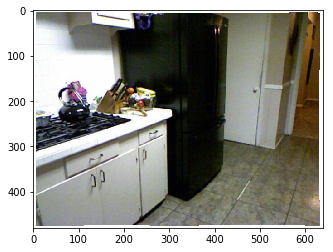

01138.jpg


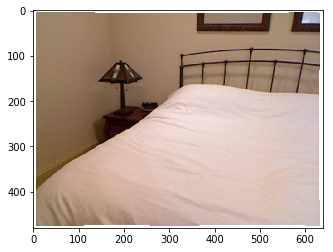

00498.png


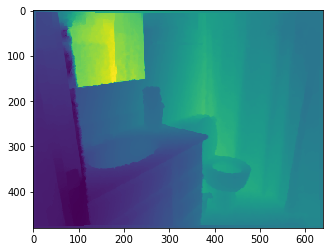

00606.png


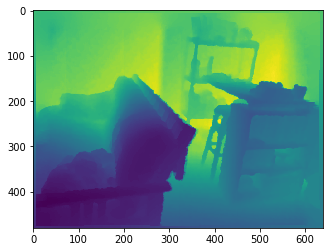

01046.png


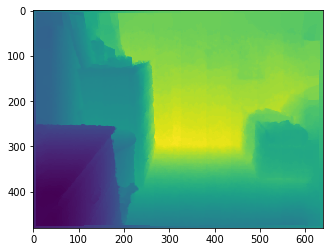

01401.jpg


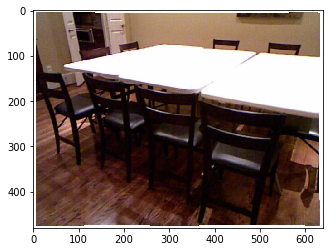

00241.jpg


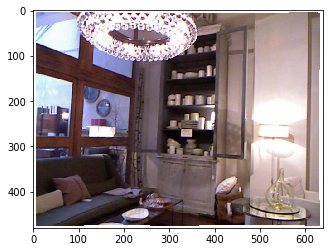

00994.jpg


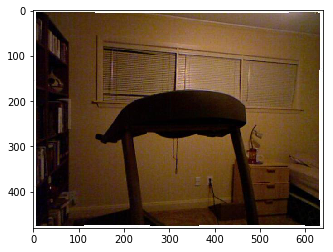

01380.png


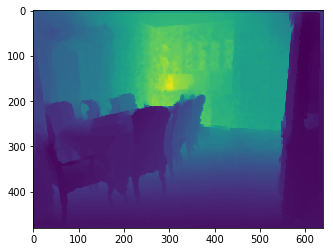

01427.png


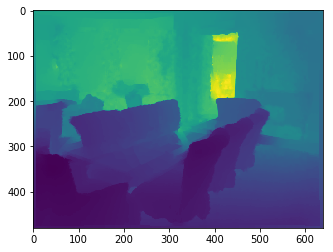

00267.png


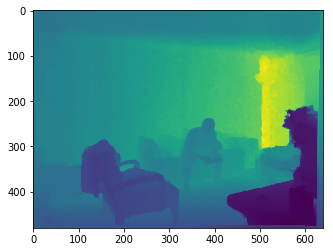

00620.jpg


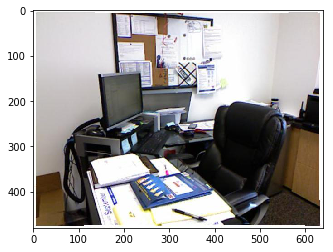

00187.jpg


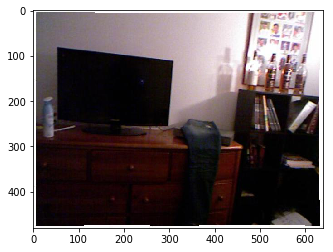

01060.jpg


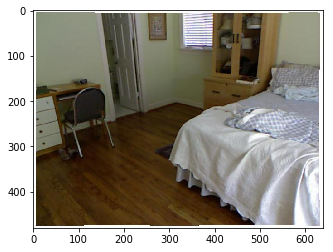

00156.jpg


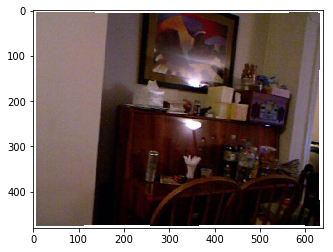

00963.png


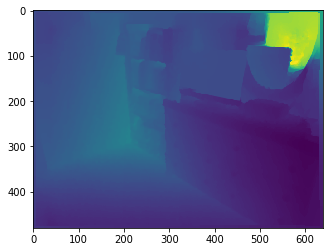

00511.png


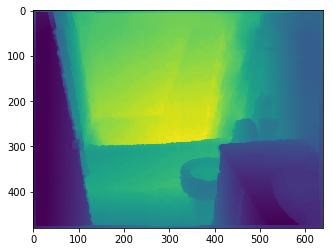

01351.png


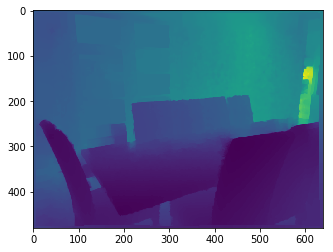

00290.jpg


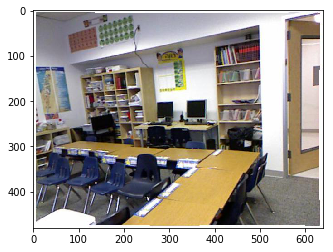

00537.jpg


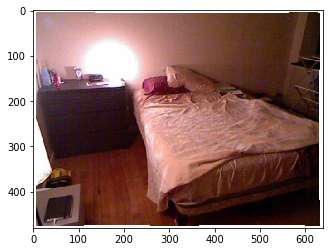

00945.jpg


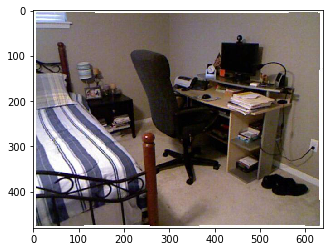

01377.jpg


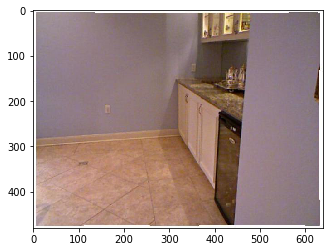

01097.png


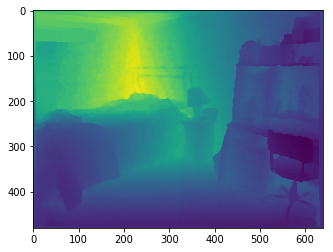

00170.png


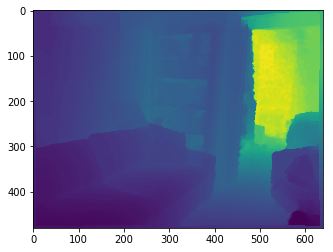

00009.jpg


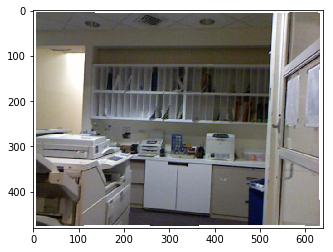

00788.png


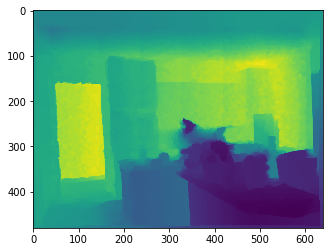

01228.jpg


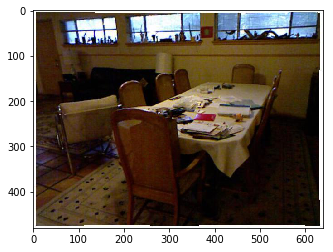

00468.jpg


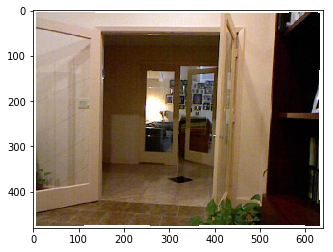

01119.png


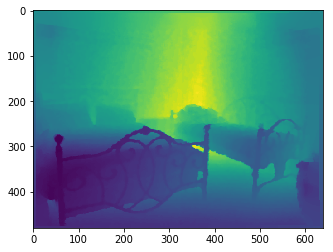

00759.png


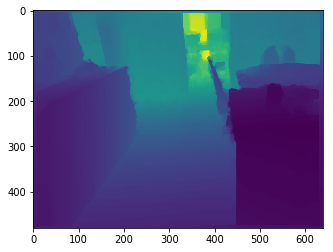

00338.png


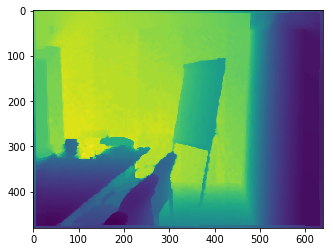

01041.png


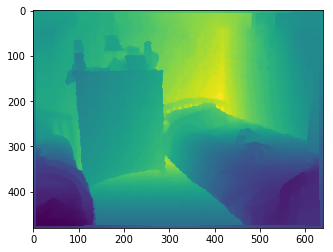

00601.png


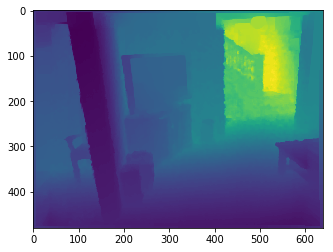

00993.jpg


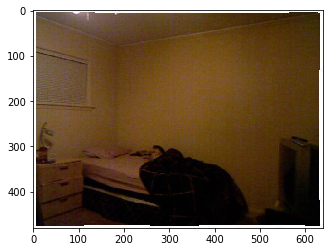

00246.jpg


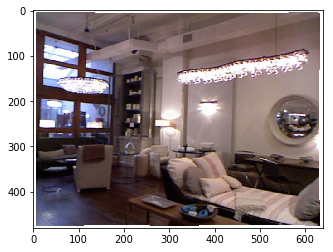

01406.jpg


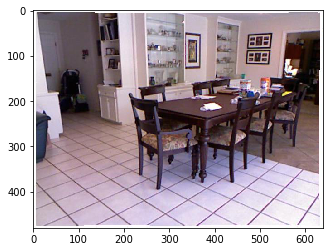

00260.png


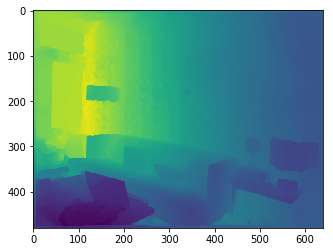

01420.png


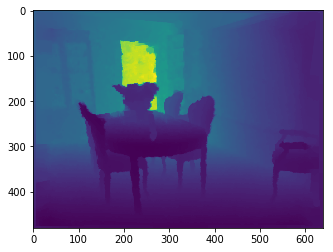

01387.png


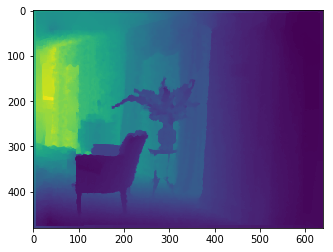

01067.jpg


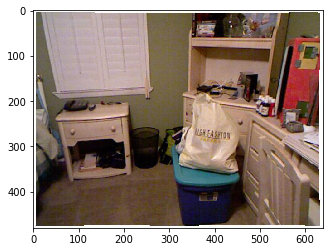

00180.jpg


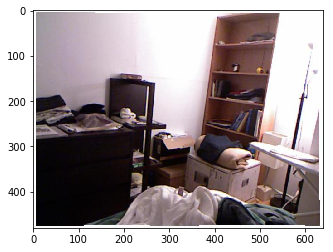

00627.jpg


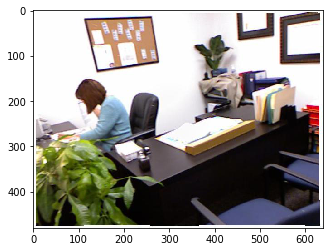

00151.jpg


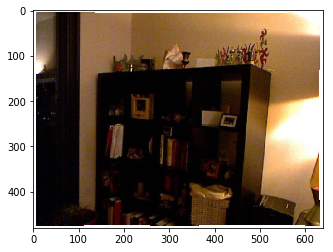

01356.png


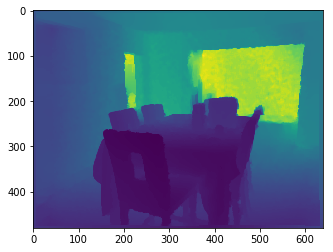

00516.png


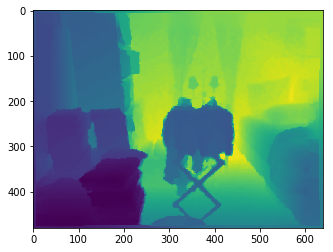

00964.png


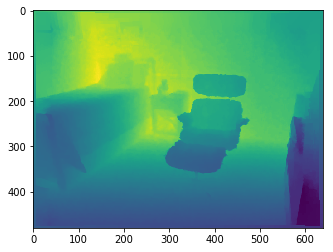

01370.jpg


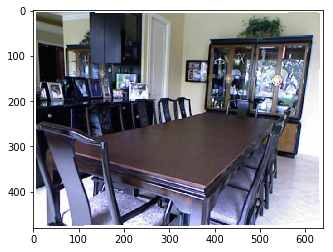

00942.jpg


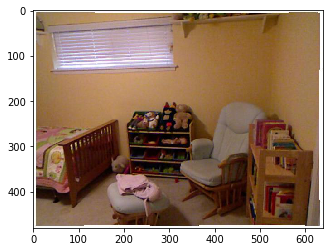

00530.jpg


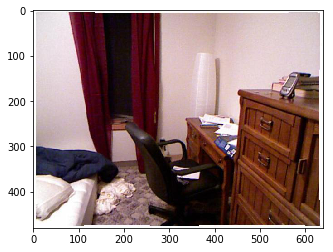

00297.jpg


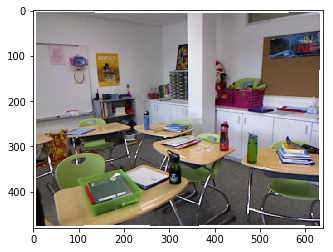

00177.png


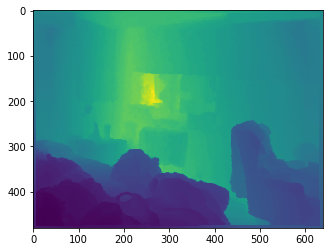

01090.png


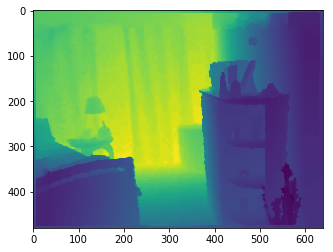

00075.jpg


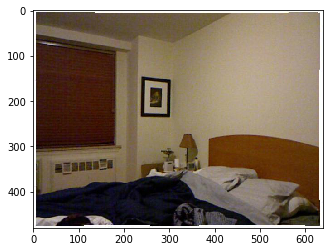

01192.jpg


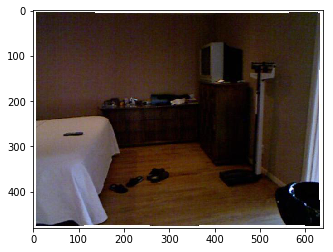

01272.png


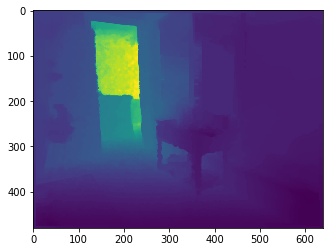

00840.png


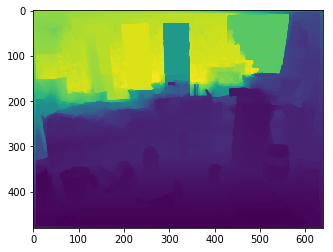

00432.png


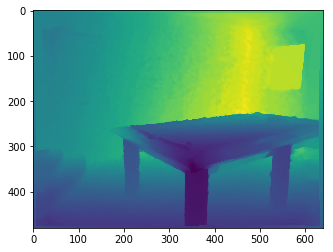

00395.png


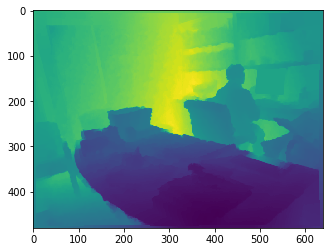

01254.jpg


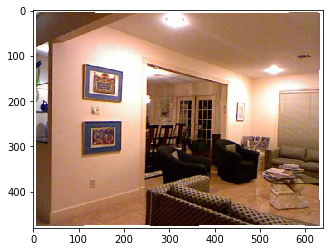

00414.jpg


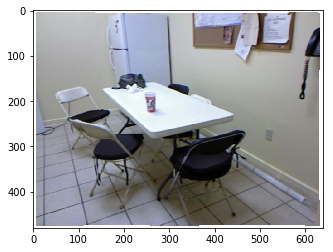

00866.jpg


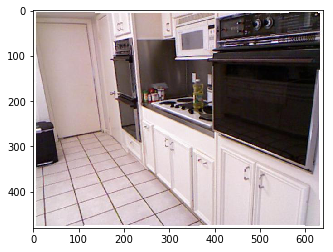

00053.png


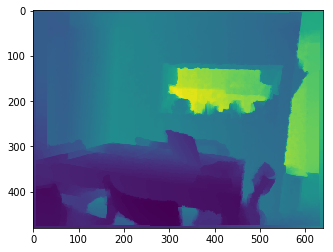

01165.png


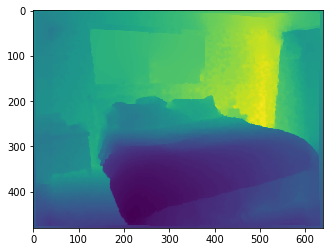

00082.png


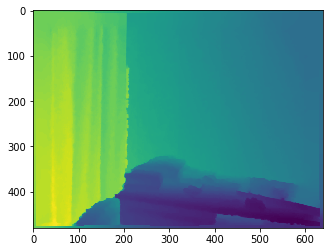

00725.png


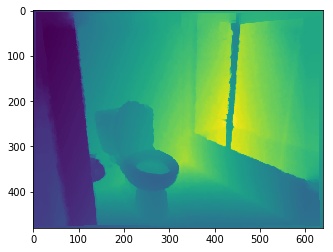

00362.jpg


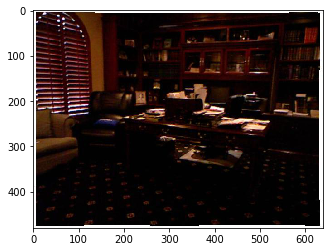

01285.jpg


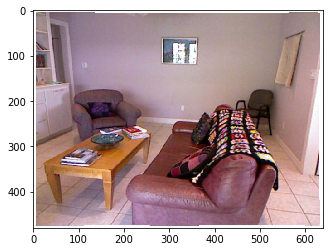

00891.png


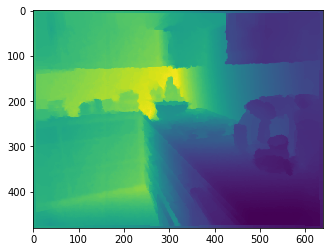

00344.png


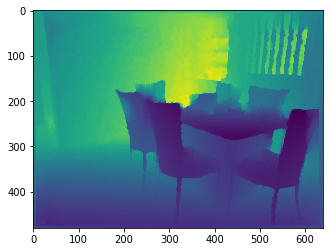

01143.jpg


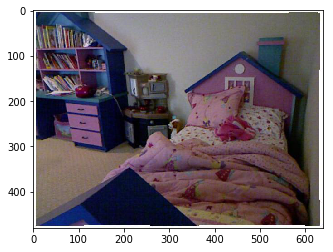

00703.jpg


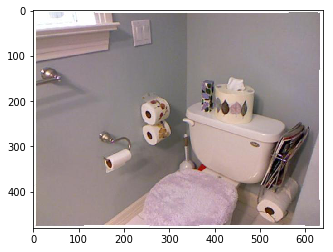

00918.png


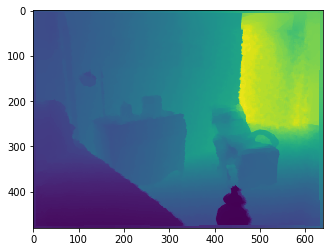

00809.png


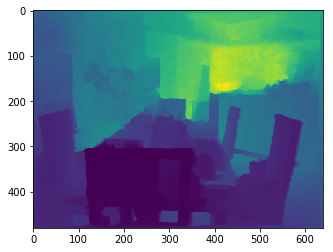

01345.jpg


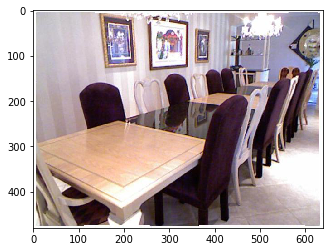

00977.jpg


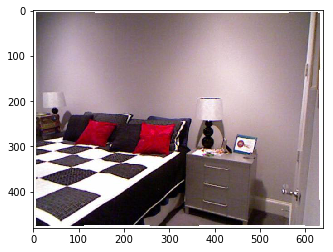

00505.jpg


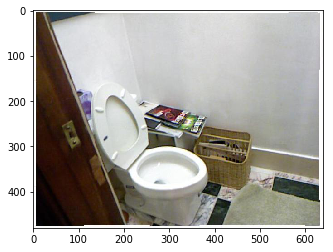

00142.png


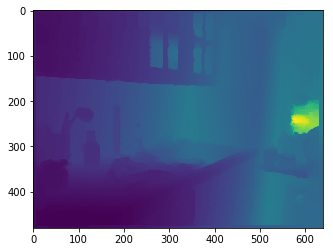

00164.jpg


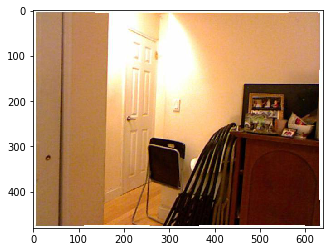

01083.jpg


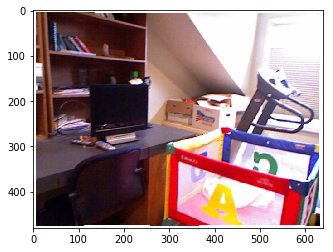

01363.png


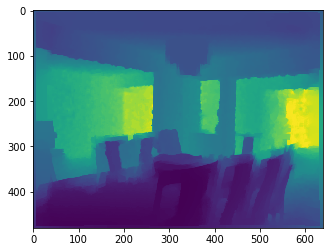

00523.png


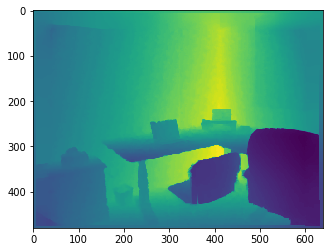

00951.png


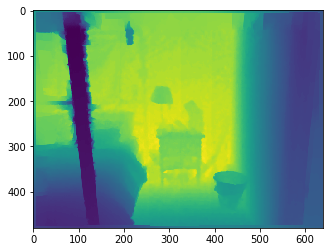

00284.png


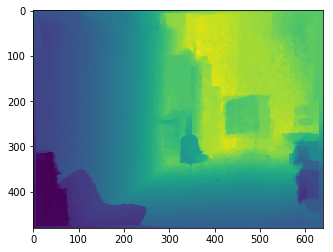

00980.png


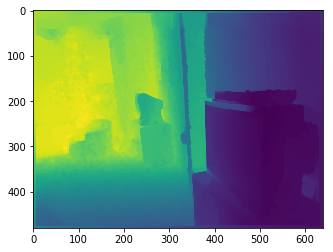

00255.png


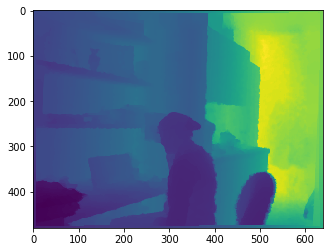

01415.png


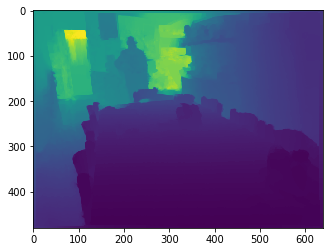

01052.jpg


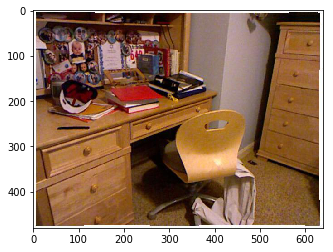

00612.jpg


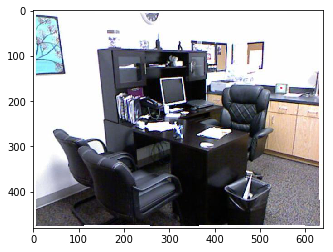

01074.png


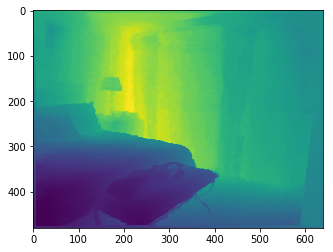

00193.png


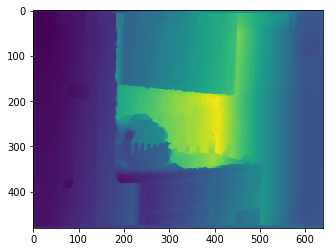

00634.png


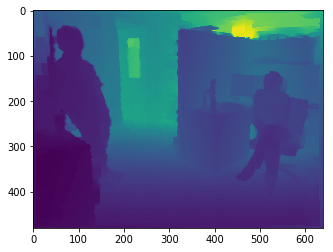

00273.jpg


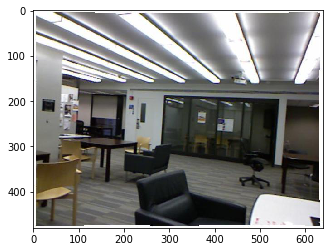

01433.jpg


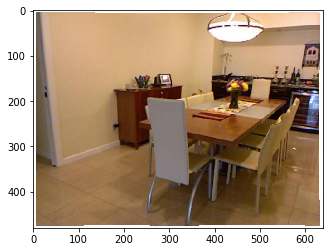

01394.jpg


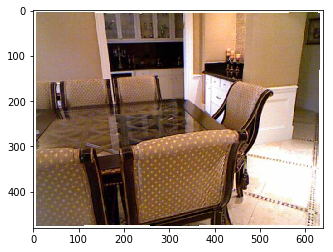

00371.png


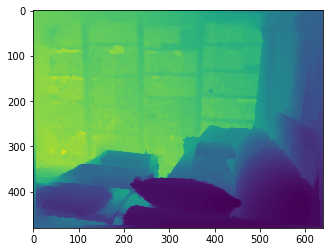

01296.png


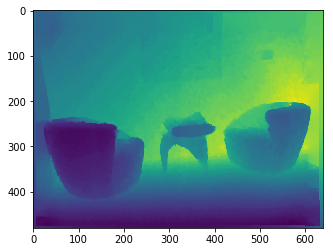

01176.jpg


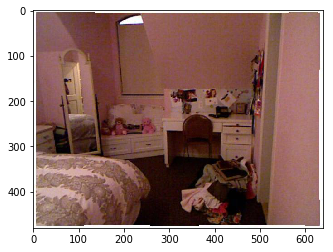

00091.jpg


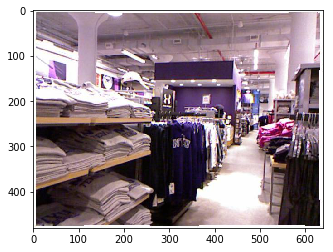

00736.jpg


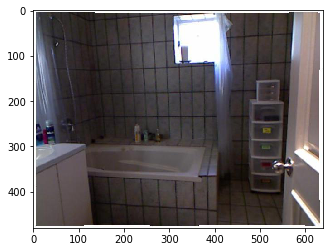

01150.png


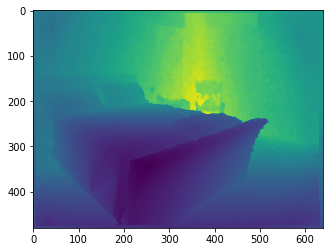

00710.png


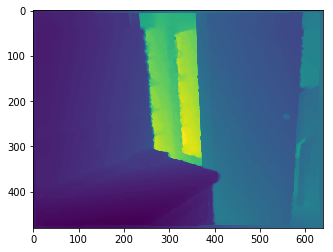

00882.jpg


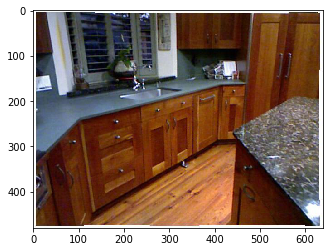

00357.jpg


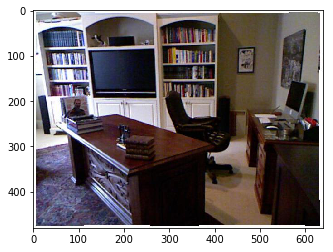

01261.jpg


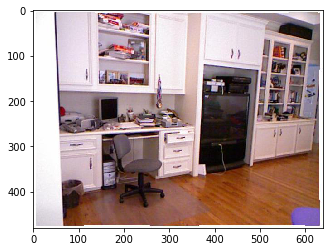

00421.jpg


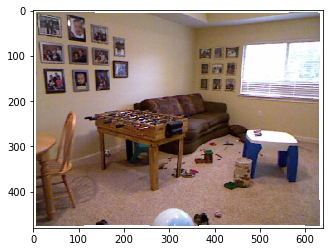

00853.jpg


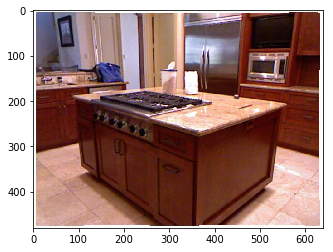

00386.jpg


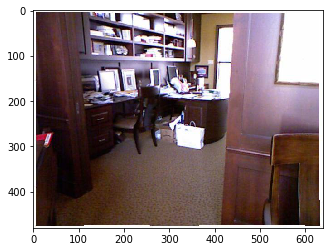

00066.png


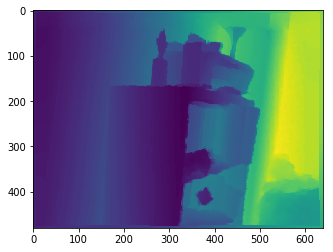

01181.png


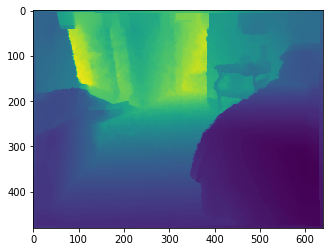

00040.jpg


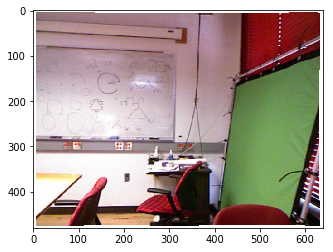

01247.png


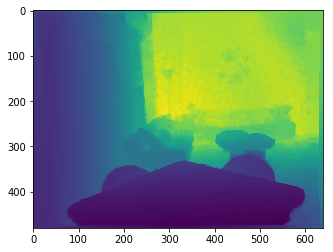

00875.png


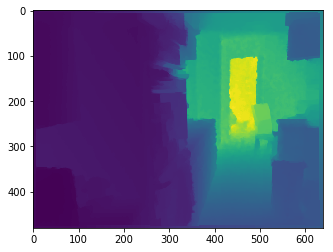

00407.png


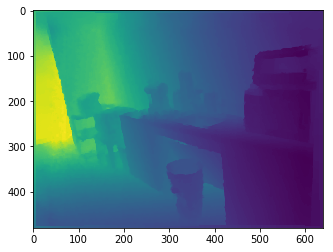

00699.png


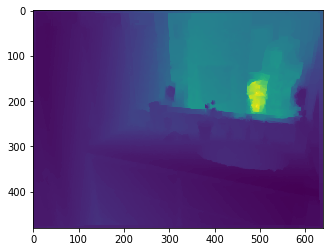

01339.jpg


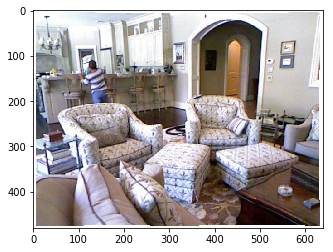

00579.jpg


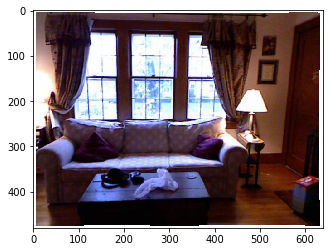

00118.jpg


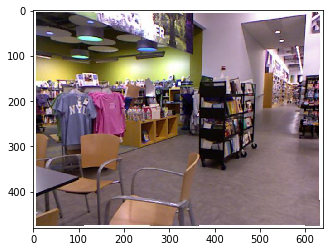

00229.png


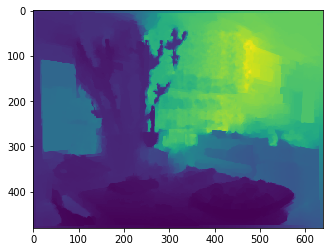

01008.png


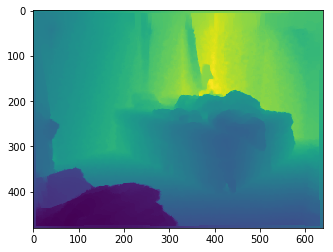

00648.png


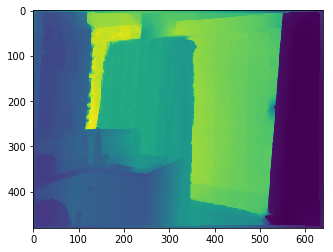

01291.png


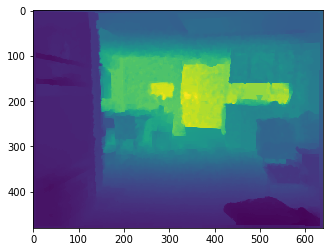

00376.png


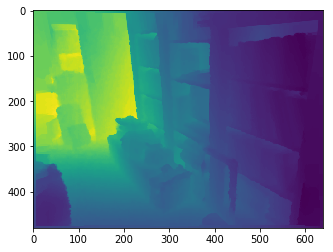

00731.jpg


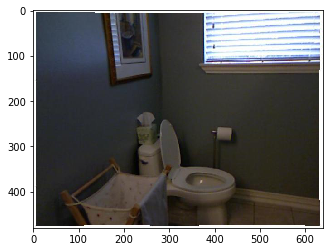

00096.jpg


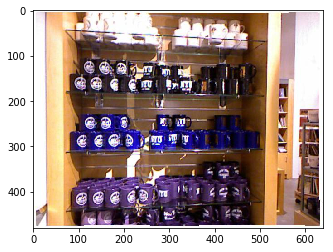

01171.jpg


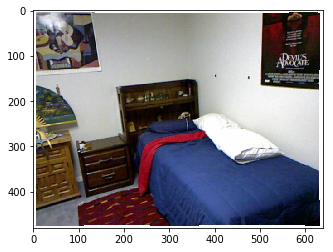

00717.png


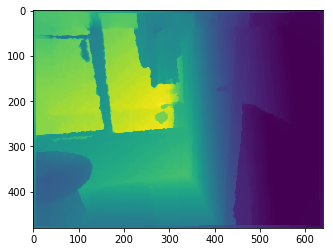

01157.png


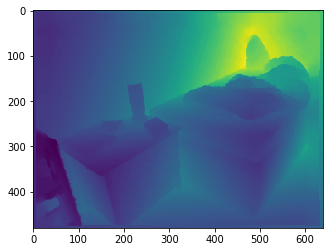

00350.jpg


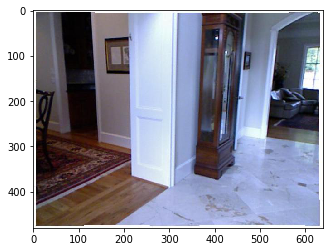

00885.jpg


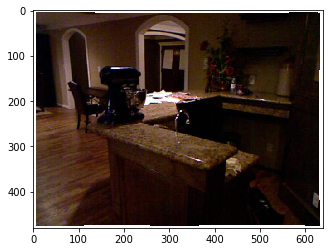

00381.jpg


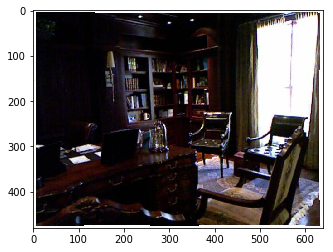

00854.jpg


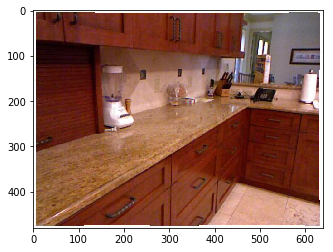

00426.jpg


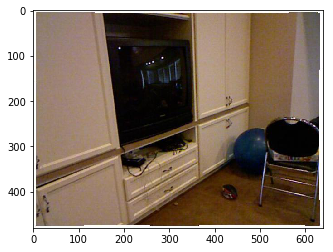

01266.jpg


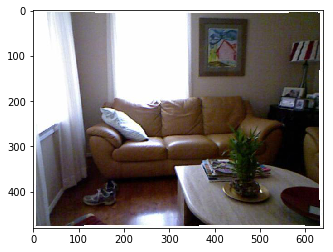

01186.png


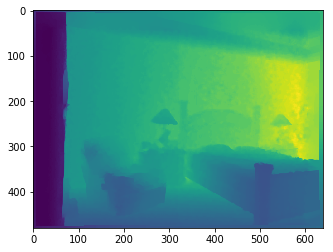

00061.png


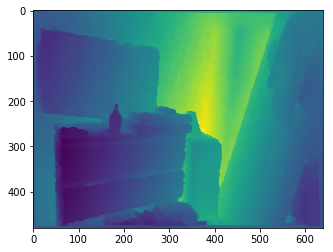

00047.jpg


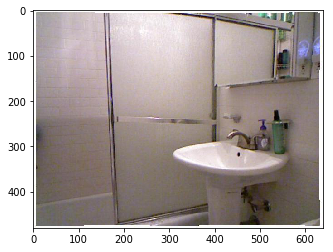

00400.png


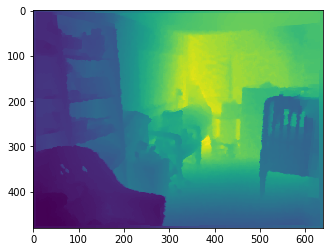

00872.png


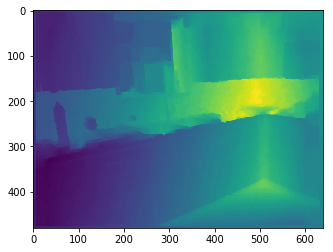

01240.png


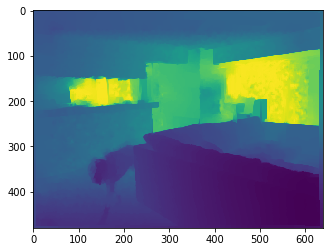

00139.png


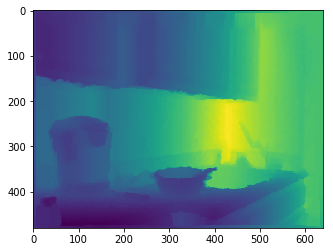

00558.png


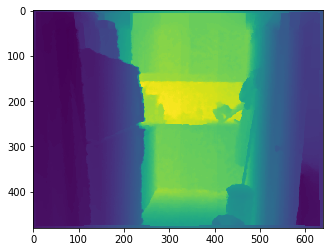

01318.png


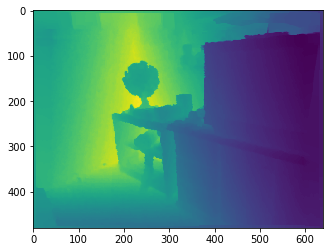

00669.jpg


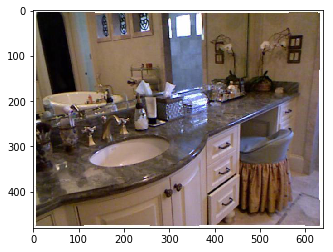

01029.jpg


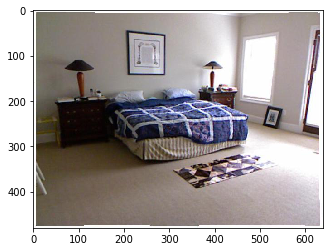

00589.png


KeyboardInterrupt: 

In [25]:
from PIL import Image
import matplotlib.image as mpimg
path = './nyu_data/'
for filename in os.listdir(path):
    print(filename)
    img=mpimg.imread(path+filename)#.convert("RGB")
    
    plt.imshow(img)
    plt.show()

In [26]:
img

array([[ 0.43529412,  0.43529412,  0.43529412, ...,  0.80000001,
         0.80000001,  0.80000001],
       [ 0.43529412,  0.43529412,  0.43529412, ...,  0.80000001,
         0.80000001,  0.80000001],
       [ 0.43529412,  0.43529412,  0.43529412, ...,  0.80000001,
         0.80000001,  0.80000001],
       ..., 
       [ 0.34509805,  0.34509805,  0.34509805, ...,  0.4509804 ,
         0.4509804 ,  0.4509804 ],
       [ 0.34509805,  0.34509805,  0.34509805, ...,  0.4509804 ,
         0.4509804 ,  0.4509804 ],
       [ 0.34509805,  0.34509805,  0.34509805, ...,  0.4509804 ,
         0.4509804 ,  0.4509804 ]], dtype=float32)

In [22]:
img.load()

In [ ]:
from tqdm import tqdm
import numpy as np
import tensorflow as tf
path = './nyu_depth_v2_labeled.mat'
f = h5py.File(path)
writer = tf.python_io.TFRecordWriter("NYU.tfrecords")
for i, (image, depth) in enumerate(zip(f['images'], f['depths'])):
        example = tf.train.Example(
        # Example contains a Features proto object
        features=tf.train.Features(
          # Features contains a map of string to Feature proto objects
          feature={
            # A Feature contains one of either a int64_list,
            # float_list, or bytes_list
            'label': tf.train.Feature(
                int64_list=tf.train.Int64List(value=depth)),
            'image': tf.train.Feature(
                int64_list=tf.train.Int64List(value=image)),
    }))
        serialized = example.SerializeToString()
        writer.write(serialized)